## General

This notebook combines the image and text models using different distance and combination heuristics.

In [1]:
# Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import nltk
import scipy
from PIL import Image
from sklearn.neighbors import NearestNeighbors
from sklearn.preprocessing import StandardScaler

In [2]:
# Set image directory
train_dir = '../datasets/train_images/'

In [3]:
# Load best image predictions and F1 scores
train_image = pd.DataFrame(np.load('../datasets/train_image_predictions.npy', allow_pickle=True),
                     columns=['posting_id', 'image', 'image_phash', 'title', 'label_group', 'matches', 'image_duplicates',
                              'predictions_6e', 'f1_scores_6e', 'predictions_6c', 'f1_scores_6c',
                              'predictions_8e', 'f1_scores_8e', 'predictions_8c', 'f1_scores_8c'])

In [4]:
# Load best text predictions and F1 scores
train_text = pd.DataFrame(np.load('../datasets/train_text_predictions.npy', allow_pickle=True),
                     columns=['posting_id', 'image', 'title', 'label_group', 'matches',
                              'tokens_2', 'text_predictions_2t', 'text_f1_scores_2t',
                              'text_predictions_2s', 'text_f1_scores_2s',
                              'tokens_3', 'text_predictions_3t', 'text_f1_scores_3t',
                              'text_predictions_3s', 'text_f1_scores_3s'])

In [5]:
# Combine best image and text predictions
train = pd.concat([# Best image predictions (image model 8c)
                   train_image[['posting_id', 'image', 'image_phash', 'title',
                                'label_group', 'matches', 'image_duplicates',
                                'predictions_8c', 'f1_scores_8c']],
                  
                   # Best text predictions (text model 3t)
                   train_text[['text_predictions_3t', 'text_f1_scores_3t']]],
                   axis=1)

train.rename(columns={'predictions_8c': 'best_image_preds_0',
                      'f1_scores_8c': 'best_image_scores_0',
                      'text_predictions_3t': 'best_text_preds_0',
                      'text_f1_scores_3t': 'best_text_scores_0'},
             inplace=True)

train['best_image_scores_0'] = train['best_image_scores_0'].astype('float64')
train['best_text_scores_0'] = train['best_text_scores_0'].astype('float64')

In [6]:
train.head()

,posting_id,image,image_phash,title,label_group,matches,image_duplicates,best_image_preds_0,best_image_scores_0,best_text_preds_0,best_text_scores_0
0,train_129225211,0000a68812bc7e98c42888dfb1c07da0.jpg,94974f937d4c2433,Paper Bag Victoria Secret,249114794,"[train_129225211, train_2278313361]",[train_129225211],[train_129225211],0.666667,"[train_129225211, train_2278313361]",1.000000
1,train_3386243561,00039780dfc94d01db8676fe789ecd05.jpg,af3f9460c2838f0f,"Double Tape 3M VHB 12 mm x 4,5 m ORIGINAL / DO...",2937985045,"[train_3386243561, train_3423213080]",[train_3386243561],"[train_3386243561, train_3423213080, train_212...",0.500000,"[train_3386243561, train_3423213080, train_197...",0.500000
2,train_2288590299,000a190fdd715a2a36faed16e2c65df7.jpg,b94cb00ed3e50f78,Maling TTS Canned Pork Luncheon Meat 397 gr,2395904891,"[train_2288590299, train_3803689425]",[train_2288590299],[train_2288590299],0.666667,"[train_2288590299, train_3803689425]",1.000000
3,train_2406599165,00117e4fc239b1b641ff08340b429633.jpg,8514fc58eafea283,Daster Batik Lengan pendek - Motif Acak / Camp...,4093212188,"[train_2406599165, train_3342059966]",[train_2406599165],"[train_2406599165, train_1593362411, train_280...",0.333333,"[train_1744956981, train_2406599165, train_352...",0.222222
4,train_3369186413,00136d1cf4edede0203f32f05f660588.jpg,a6f319f924ad708c,Nescafe \xc3\x89clair Latte 220ml,3648931069,"[train_3369186413, train_921438619]",[train_3369186413],"[train_3369186413, train_921438619]",1.000000,[train_3369186413],0.666667


In [7]:
# Create function to score predictions based on actual matches
def scores(matches, preds):
    result = []
    for i in range(len(matches)):
        n = len(np.intersect1d(matches[i], preds[i]))
        score = 2*n / (len(matches[i]) + len(preds[i]))
        result.append(score)
    return result

In [8]:
# Obtain matches
matches = list(train['matches'].to_numpy())

## Baseline Heuristics

As a start, we can combine the best image predictions with the best text predictions using either the union or intersection of the 2 sets of predictions.

- Set union of image and text predictions
- Set intersection of image and text predictions

### Set Union of Image and Text Predictions

As a baseline, try the set union of image and text predictions.

In [9]:
# Create combined predictions using union of image and text predictions
preds_union = []

for i in range(train.shape[0]):
    preds_union.append(np.union1d(train['best_image_preds_0'].iloc[i], train['best_text_preds_0'].iloc[i]))

In [10]:
# Check average score
np.mean(scores(matches, preds_union))

0.7451648274871532

In [11]:
# Create column in train df for baseline combined predictions and scores
train['combined_preds_0'] = preds_union
train['combined_scores_0'] = scores(matches, preds_union)

### Set Intersection of Image and Text Predictions

Try the set intersection of image and text predictions.

In [12]:
# Create combined predictions using union of image and text predictions
preds_intersect = []

for i in range(train.shape[0]):
    preds_intersect.append(np.intersect1d(train['best_image_preds_0'].iloc[i], train['best_text_preds_0'].iloc[i]))

In [13]:
# Check average score
np.mean(scores(matches, preds_intersect))

0.6063594482704427

As expected, there are not many products that are similar in <em>both</em> image and text, thus the intersection scores are lower.

## Explore Image/Text Distances and Indices

Currently, the best image predictions use a fixed cosine distance threshold of 0.233, the best TF-IDF text predictions use a fixed threshold of 0.433 and the best LaBSE embedding model uses a fixed threshold of 0.2.

Explore the actual image/text distances of the product matches as well as the predictions to develop a better heuristic.

In [14]:
# Import scipy distance metric
from scipy.spatial import distance

In [15]:
# Load image/text distances and indices
image_distances = np.load('../datasets/best_image_distances.npy')
image_indices = np.load('../datasets/best_image_indices.npy')

text_distances = np.load('../datasets/best_text_distances.npy')
text_indices = np.load('../datasets/best_text_indices.npy')

text_labse_distances = np.load('../datasets/best_text_labse_distances.npy')
text_labse_indices = np.load('../datasets/best_text_labse_indices.npy')

In [16]:
# Load best image/text embeddings
image_embeddings = np.load('../datasets/train_image_embeddings_8.npy', allow_pickle=True)
text_embeddings = scipy.sparse.load_npz('../datasets/train_text_embeddings.npz')
text_labse_embeddings = np.load('../datasets/text_labse_embeddings_2.npy', allow_pickle=True)

In [20]:
# Combine all image/text distances respectively
all_image_distances = np.concatenate(image_distances)
all_text_distances = np.concatenate(text_distances)
all_text_labse_distances = np.concatenate(text_labse_distances)

In [17]:
# Generate image distances of actual product matches
actual_image_distances = []
for i in range(train.shape[0]):
    distances = []
    matches = train['matches'].iloc[i]
    
    # Obtain indexes of matches
    for match in matches:
        match_idx = train[train['posting_id'] == match].index.values[0]
        
        # Calculate cosine distance of matches to product
        distances.append(distance.cosine(image_embeddings[i], image_embeddings[match_idx]))
    
    actual_image_distances.append(distances)

In [18]:
# Generate text (TF-IDF) distances of actual product matches
actual_text_distances = []
for i in range(train.shape[0]):
    distances = []
    matches = train['matches'].iloc[i]
    
    # Obtain indexes of matches
    for match in matches:
        match_idx = train[train['posting_id'] == match].index.values[0]
        
        # Calculate cosine distance of matches to product
        distances.append(distance.cosine(text_embeddings[i].todense(), text_embeddings[match_idx].todense()))
    
    actual_text_distances.append(distances)

In [19]:
# Generate text (LaBSE) distances of actual product matches
actual_text_labse_distances = []
for i in range(train.shape[0]):
    distances = []
    matches = train['matches'].iloc[i]
    
    # Obtain indexes of matches
    for match in matches:
        match_idx = train[train['posting_id'] == match].index.values[0]
        
        # Calculate cosine distance of matches to product
        distances.append(distance.cosine(text_labse_embeddings[i], text_labse_embeddings[match_idx]))
    
    actual_text_labse_distances.append(distances)

In [21]:
# Save distances of actual matches to train dataframe
train['match_image_distances'] = [[round(i, 2) for i in distances] for distances in actual_image_distances]
train['match_text_distances'] = [[round(i, 2) for i in distances] for distances in actual_text_distances]
train['match_text_labse_distances'] = [[round(i, 2) for i in distances] for distances in actual_text_labse_distances]

In [22]:
# Save distances of predictions to train dataframe
train['pred_image_distances'] = [[round(i, 2) for i in distances] for distances in image_distances]
train['pred_text_distances'] = [[round(i, 2) for i in distances] for distances in text_distances]
train['pred_text_labse_distances'] = [[round(i, 2) for i in distances] for distances in text_labse_distances]

In [23]:
# Save average distances of predictions to train dataframe
train['pred_image_distances_avg'] = [round(np.mean(i),2) for i in train['pred_image_distances']]
train['pred_text_distances_avg'] = [round(np.mean(i),2) for i in train['pred_text_distances']]
train['pred_text_labse_distances_avg'] = [round(np.mean(i),2) for i in train['pred_text_labse_distances']]

### Distribution of Image/Text Distances

Plot the distance distributions of the actual product matches and the image/text predictions

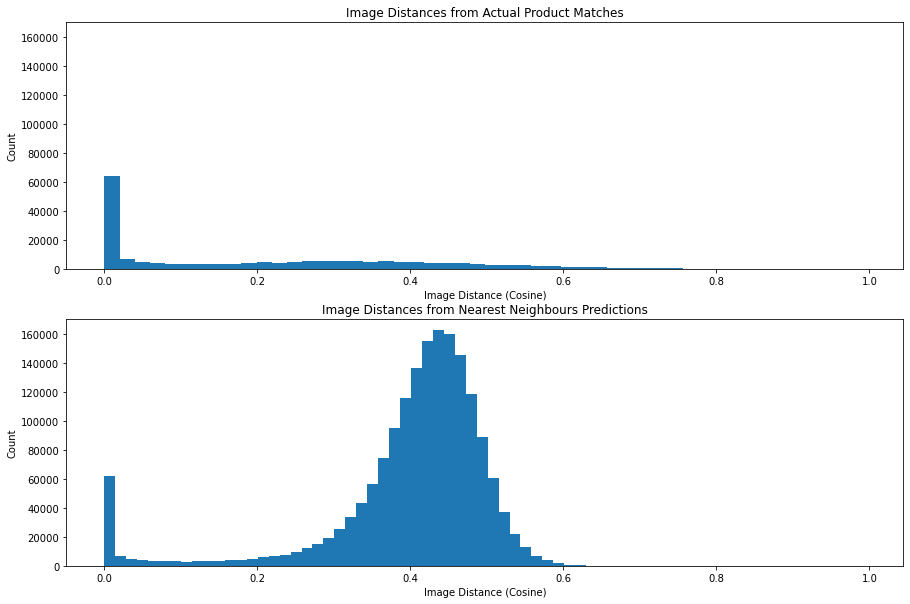

In [30]:
# Check image distance distribution of actual matches vs predictions
plt.figure(figsize=(15,10))

ax1 = plt.subplot(211)
plt.hist(np.concatenate(actual_image_distances), bins = 50)
plt.xlabel('Image Distance (Cosine)')
plt.ylabel('Count')
plt.title('Image Distances from Actual Product Matches')

ax2 = plt.subplot(212, sharex = ax1, sharey = ax1)
plt.hist(all_image_distances, bins = 50)
plt.xlabel('Image Distance (Cosine)')
plt.ylabel('Count')
plt.title('Image Distances from Nearest Neighbours Predictions');

The image distances of the actual product matches have a peak at 0, meaning the images for matching products are exactly the same or very similar.

Beyond that, there is a long tail in the distribution of image distances of actual product matches. This means some product matches could have images that range from similar to highly dissimilar, which follows what was discovered in the EDA.

Examining the image distance distribution of our nearest neighbours predictions, there is a peak at 0 as well. 

However beyond that, there is a sharp increase in the distribution between cosine distance 0.2 to 0.4. This explains why the best cosine threshold for the image model is 0.233, as beyond that the model will make too many predictions and reduce the score.

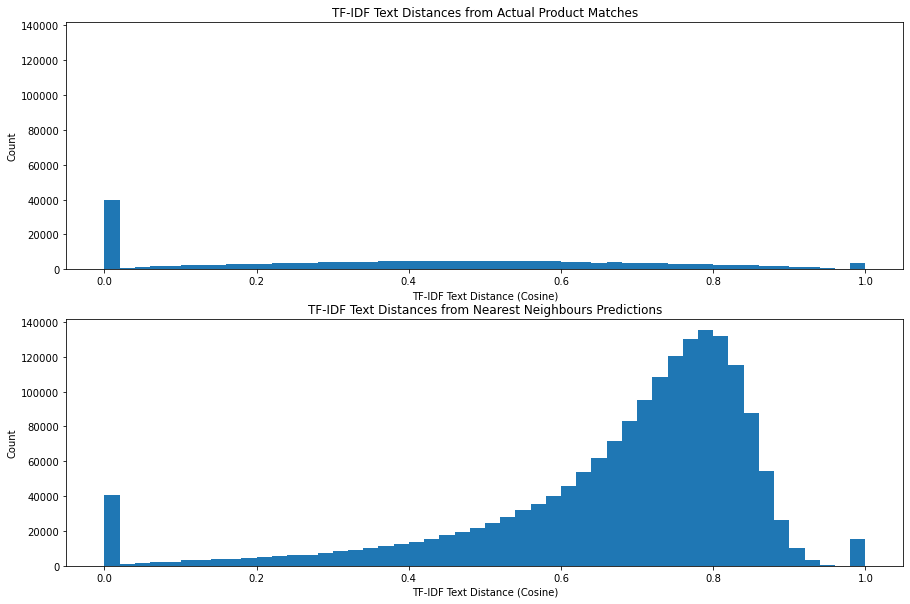

In [32]:
# Check distribution of TF-IDF text distances of actual matches vs predictions
plt.figure(figsize=(15,10))

ax1 = plt.subplot(211)
plt.hist(np.concatenate(actual_text_distances), bins = 50)
plt.xlabel('TF-IDF Text Distance (Cosine)')
plt.ylabel('Count')
plt.title('TF-IDF Text Distances from Actual Product Matches')

ax2 = plt.subplot(212, sharex = ax1, sharey = ax1)
plt.hist(all_text_distances, bins = 50)
plt.xlabel('TF-IDF Text Distance (Cosine)')
plt.ylabel('Count')
plt.title('TF-IDF Text Distances from Nearest Neighbours Predictions');

Similar to the image distances, the TF-IDF embedding model has a peak at 0 in the distribution where the title tokens of product matches are exactly the same or highly similar.

For the predictions, there is a sharp increase in the distribution between cosine distance 0.4 to 0.8. This explains why the best text model has a cosine distance threshold of 0.433, as beyond that the model will make too many predictions.

There is a small peak at cosine distance 1.0. This could be where the titles do not have any shared tokens in the TF-IDF embedding.

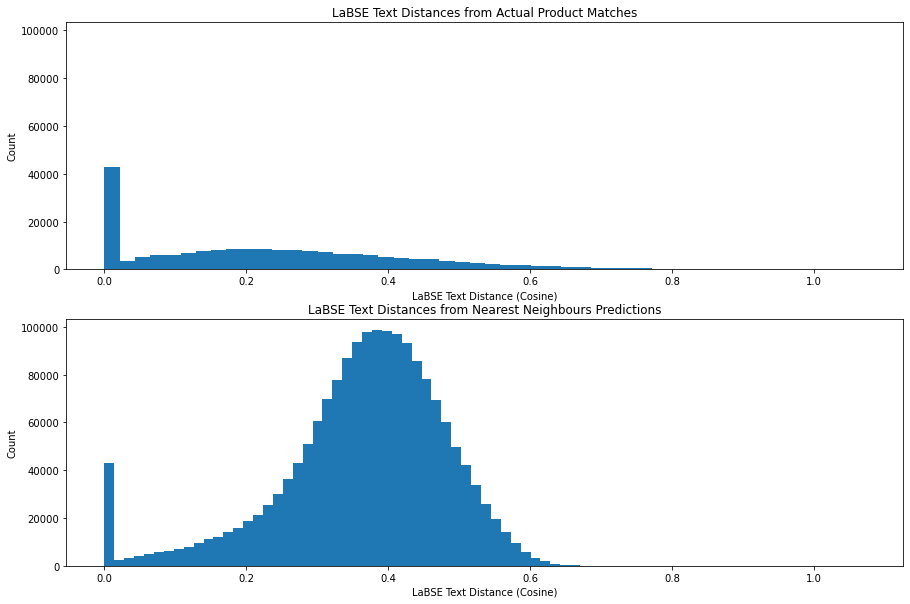

In [33]:
# Check distribution of LaBSE text distances of actual matches vs predictions
plt.figure(figsize=(15,10))

ax1 = plt.subplot(211)
plt.hist(np.concatenate(actual_text_labse_distances), bins = 50)
plt.xlabel('LaBSE Text Distance (Cosine)')
plt.ylabel('Count')
plt.title('LaBSE Text Distances from Actual Product Matches')

ax2 = plt.subplot(212, sharex = ax1, sharey = ax1)
plt.hist(all_text_labse_distances, bins = 50)
plt.xlabel('LaBSE Text Distance (Cosine)')
plt.ylabel('Count')
plt.title('LaBSE Text Distances from Nearest Neighbours Predictions');

The LaBSE embedding model does not have as long a tail as the TF-IDF embedding model for the distance distribution of actual product matches.

Perhaps because of the smaller feature vector (768 vs 25,023), the cosine distances of product neighbours is generally smaller for the LaBSE model compared to the TF-IDF model.

The best cosine distance threshold is 0.2, beyond which the LaBSE embedding model starts making too many predictions.

The LaBSE embedding model has slightly more product neighbours at distance 0 (42,000) compared with the TF-IDF model (40,000).

### F1 Scores = 1

Examine cosine distances of actual matches and our predictions that scored F1 score of 1.0.

In [39]:
view = ['title', 'matches',
        'match_image_distances', 'match_text_distances', 'match_text_labse_distances',
        'pred_image_distances', 'pred_image_distances_avg',
        'pred_text_distances', 'pred_text_distances_avg', 
        'pred_text_labse_distances', 'pred_text_labse_distances_avg',]

In [40]:
# Explore products with combined scores = 1
train.loc[train['combined_scores_0'] == 1][view].head()

,title,matches,match_image_distances,match_text_distances,match_text_labse_distances,pred_image_distances,pred_image_distances_avg,pred_text_distances,pred_text_distances_avg,pred_text_labse_distances,pred_text_labse_distances_avg
0,Paper Bag Victoria Secret,"[train_129225211, train_2278313361]","[0.0, 0.69]","[0.0, 0.0]","[0.0, 0.0]","[0.0, 0.24, 0.24, 0.26, 0.28, 0.28, 0.28, 0.28...",0.30,"[0.0, 0.0, 0.6, 0.64, 0.68, 0.68, 0.71, 0.72, ...",0.74,"[0.0, 0.0, 0.37, 0.42, 0.42, 0.44, 0.44, 0.45,...",0.46
2,Maling TTS Canned Pork Luncheon Meat 397 gr,"[train_2288590299, train_3803689425]","[0.0, 0.56]","[0.0, 0.34]","[0.0, 0.1]","[-0.0, 0.36, 0.37, 0.42, 0.43, 0.43, 0.44, 0.4...",0.47,"[0.0, 0.34, 0.79, 0.82, 0.83, 0.83, 0.84, 0.86...",0.88,"[0.0, 0.1, 0.39, 0.42, 0.42, 0.42, 0.43, 0.44,...",0.46
4,Nescafe \xc3\x89clair Latte 220ml,"[train_3369186413, train_921438619]","[0.0, 0.12]","[0.0, 0.65]","[0.0, 0.18]","[-0.0, 0.12, 0.32, 0.33, 0.42, 0.42, 0.42, 0.4...",0.45,"[0.0, 0.65, 0.68, 0.74, 0.76, 0.76, 0.76, 0.77...",0.80,"[0.0, 0.18, 0.35, 0.36, 0.36, 0.36, 0.37, 0.37...",0.40
7,KULOT PLISKET SALUR /CANDY PLISKET /WISH KULOT...,"[train_1806152124, train_3227306976]","[0.0, 0.41]","[0.0, 0.42]","[0.0, 0.44]","[0.0, 0.34, 0.35, 0.37, 0.37, 0.38, 0.38, 0.38...",0.41,"[0.0, 0.42, 0.45, 0.47, 0.56, 0.58, 0.6, 0.6, ...",0.69,"[0.0, 0.38, 0.4, 0.42, 0.43, 0.43, 0.43, 0.44,...",0.45
9,BIG SALE SEPATU PANTOFEL KULIT KEREN KERJA KAN...,"[train_831680791, train_3031035861]","[0.0, 0.07]","[0.0, 0.56]","[0.0, 0.23]","[0.0, 0.07, 0.26, 0.29, 0.3, 0.3, 0.31, 0.31, ...",0.34,"[0.0, 0.5, 0.52, 0.52, 0.55, 0.56, 0.57, 0.61,...",0.70,"[0.0, 0.15, 0.17, 0.17, 0.2, 0.2, 0.21, 0.21, ...",0.29


The set union of image and text predictions improves the overall score as the text features help identify similar products where the image features cannot and vice versa.

For example in the 'Paper Bag Victoria Secret' product above, the image cosine distance of its product match is 0.69. This was not predicted by the image model as the threshold is 0.233. (If the threshold was set to above 0.69, several unrelated products would have been predicted as well, reducing the score.) However, as the text cosine distance of its product match is 0.0, the text model predicted it. The set union of the image and text model thus gave a combined score of 1.

Similarly for the 'Nescafe \xc3\x89clair Latte 220ml' product, the text cosine distance of its product match is 0.65, which was not predicted by the text model. However the image cosine distance of its product match is 0.12, which was predicted by the image model.

### F1 Scores = 0.667

In [42]:
# Explore products with combined scores = 0.666667
train.loc[train['combined_scores_0'] == 2/3][view].head()

,title,matches,match_image_distances,match_text_distances,match_text_labse_distances,pred_image_distances,pred_image_distances_avg,pred_text_distances,pred_text_distances_avg,pred_text_labse_distances,pred_text_labse_distances_avg
27,[Shiyan] mainan gigitan bayi set pack baby tee...,"[train_3466601092, train_354147588]","[0.0, 0.01]","[0.0, 0.52]","[0.0, 0.15]","[0.0, 0.01, 0.18, 0.21, 0.24, 0.24, 0.26, 0.27...",0.30,"[0.0, 0.52, 0.55, 0.58, 0.59, 0.61, 0.62, 0.62...",0.66,"[0.0, 0.14, 0.15, 0.17, 0.2, 0.21, 0.21, 0.21,...",0.24
32,Alat Facial Wajah 5 in 1 / Face Beauty Care Ma...,"[train_1461445798, train_1749322479]","[0.0, 0.01]","[0.0, 0.41]","[0.0, 0.12]","[0.0, 0.01, 0.38, 0.42, 0.43, 0.45, 0.45, 0.45...",0.47,"[0.0, 0.1, 0.41, 0.42, 0.61, 0.67, 0.67, 0.68,...",0.70,"[0.0, 0.04, 0.12, 0.13, 0.26, 0.29, 0.29, 0.29...",0.32
58,Packing Kardus Tambahan - Packing Ekstra Kardu...,"[train_3663748113, train_1398921910, train_250...","[0.0, 0.0, 0.0, 0.02]","[0.0, 0.5, 0.48, 0.42]","[0.0, 0.3, 0.14, 0.16]","[-0.0, -0.0, 0.0, 0.02, 0.09, 0.21, 0.31, 0.31...",0.39,"[0.0, 0.24, 0.39, 0.42, 0.45, 0.48, 0.48, 0.5,...",0.58,"[0.0, 0.14, 0.14, 0.16, 0.19, 0.2, 0.21, 0.21,...",0.26
65,Nova NS-216 Alat Cukur Janggut Shaver Hair Cli...,"[train_1612784649, train_4227549842, train_264...","[0.0, 0.63, 0.58, 0.7, 0.61]","[0.0, 0.38, 0.16, 0.4, 0.46]","[0.0, 0.07, 0.02, 0.04, 0.1]","[0.0, 0.39, 0.39, 0.4, 0.4, 0.4, 0.43, 0.44, 0...",0.47,"[0.0, 0.16, 0.33, 0.33, 0.36, 0.38, 0.4, 0.44,...",0.58,"[0.0, 0.02, 0.04, 0.04, 0.07, 0.1, 0.1, 0.1, 0...",0.22
68,TAS SELEMPANG WANITA SOPHIE MARTIN KULIT MURAH...,"[train_2010199669, train_4248414934, train_189...","[0.0, 0.25, 0.11]","[0.0, 0.55, 0.63]","[0.0, 0.4, 0.39]","[0.0, 0.11, 0.25, 0.35, 0.38, 0.38, 0.39, 0.39...",0.42,"[0.0, 0.36, 0.5, 0.52, 0.54, 0.55, 0.56, 0.58,...",0.70,"[0.0, 0.07, 0.15, 0.17, 0.18, 0.18, 0.22, 0.22...",0.33


For the '[Shiyan] mainan gigitan bayi set pack baby tee...' example above, the actual product match has an image cosine distance of 0.01. However as the image model threshold is 0.233, too many predictions were made as there are products with cosine distance 0.01, 0.18 and 0.21 as well.

For the 'TAS SELEMPANG WANITA SOPHIE MARTIN KULIT MURAH...' example above, the actual product matches have image cosine distance of 0.11 and 0.25. However as the threshold is 0.233, the product having image cosine distance of 0.25 was not predicted.

A soft distance heuristic may be better instead of a fixed threshold.

## Prediction Heuristics

Currently, the best image predictions use a fixed cosine distance threshold of 0.233, the best TF-IDF text predictions use a fixed threshold of 0.433 and the best LaBSE embedding model uses a fixed threshold of 0.2.

Possible heuristics to combine image and text embeddings to improve predictions:

- Density based distance threshold:
    - Set different distance thresholds for each product, based on the distances of the nearest neighbours. If the average distance of the nearest neighbours is smaller, use a smaller threshold.
- Combined embeddings:
    - Concatenate image and text embeddings to form a common feature space. Do a distance search of nearest neighbours using this combined feature space.
- Ensemble models:
    - Create ensemble models combining best image model, best TF-IDF text model, best LaBSE model and best combined embedding model using the set union of each model's predictions

### Density-based Distance Heuristic
- If the average image/text distance for a product's predicted neighbours is lower, use a lower distance threshold
- If the average image/text distance for a product's predicted neighbours is higher, use a higher distance threshold
- Set distance threshold to be a **ratio of average image/text distance of predicted neighbours**
- Use set union of final image/text predictions

#### Image + TF-IDF Models

In [43]:
# Check the average image distance of the 50 nearest image neighbours
np.mean([np.mean(i) for i in image_distances])

0.39890698

In [44]:
# Check the average text distance of the 50 nearest TF-IDF text neighbours
np.mean([np.mean(i) for i in text_distances])

0.678338417852965

In [46]:
# Check ratio of current fixed image threshold (0.2333) against average image distance
0.2333 / 0.39890698

0.5848481267487473

In [47]:
# Check ratio of current fixed TF-IDF text threshold (0.4333) against average text distance
0.4333 / 0.678338417852965

0.6387667108276935

In [87]:
# Set default image and text distance ratios
image_ratio = 0.58
text_ratio = 0.64

In [53]:
# Create function to predict based on image and text distances.
# Returns image predictions, text predictions and set union predictions
def predict_1(df, image_distances, image_indices, text_distances, text_indices, image_ratio, text_ratio):
    preds_union = []

    for i in range(df.shape[0]):
        
        # Set image threshold based on ratio of average image distance
        image_threshold = image_ratio * np.mean(image_distances[i])
        image_idx = image_indices[i][np.where(image_distances[i] <= image_threshold)]
        image_ids = df['posting_id'].iloc[image_idx].values
        
        # Set text threshold based on ratio of average text distance
        text_threshold = text_ratio * np.mean(text_distances[i])
        
        # Exclude text distances of 1 also
        text_idx = text_indices[i][(np.where((text_distances[i] <= text_threshold) & (text_distances[i] != 1)))]
        text_ids = df['posting_id'].iloc[text_idx].values
        
        preds_union.append(np.union1d(image_ids, text_ids))

    return preds_union

In [89]:
# Create predictions from default image and text distance ratios
preds_1 = predict_1(train, image_distances, image_indices, text_distances, text_indices, image_ratio, text_ratio)

In [56]:
matches = list(train['matches'].to_numpy())

In [91]:
# Check average F1 score of set union predictions from default ratios
np.mean(scores(matches, preds_1))

0.7627802848312543

In [95]:
# Grid search various image and text ratios
image_ratios = np.linspace(0.5,0.66,5)
text_ratios = np.linspace(0.56,0.72,5)

best_score = 0
best_ratios = [0,0]

for image_ratio in image_ratios:
    for text_ratio in text_ratios:
        preds = predict_1(train, image_distances, image_indices, text_distances, text_indices, image_ratio, text_ratio)
        score = np.mean(scores(matches,preds))
        if score >= best_score:
            best_score = score
            best_ratios[0] = image_ratio
            best_ratios[1] = text_ratio
            print(f'Current best score is {best_score} at image ratio {image_ratio} and text ratio {text_ratio}')
            
print(f'Best F1 score is {best_score} at image ratio {best_ratios[0]} and text ratio {best_ratios[1]}')

Current best score is 0.7691454244482542 at image ratio 0.5 and text ratio 0.56
Current best score is 0.7706472939813143 at image ratio 0.54 and text ratio 0.56
Current best score is 0.7723712132878379 at image ratio 0.5800000000000001 and text ratio 0.56
Current best score is 0.772868470305518 at image ratio 0.62 and text ratio 0.56
Best F1 score is 0.772868470305518 at image ratio 0.62 and text ratio 0.56


#### Image + LaBSE Models

In [49]:
# Check the average text distance of the 50 nearest LaBSE text neighbours
np.mean([np.mean(i) for i in text_labse_distances])

0.36459664

In [50]:
# Check ratio of current fixed LaBSE threshold (0.2) against average LaBSE distance
0.2 / 0.36459664

0.5485514073854328

In [51]:
# Set default image and LaBSE text distance ratios
image_ratio = 0.58
text_labse_ratio = 0.55

In [54]:
# Create predictions from default image and text distance ratios
preds_1_labse = predict_1(train, image_distances, image_indices,
                         text_labse_distances, text_labse_indices,
                         image_ratio, text_labse_ratio)

In [57]:
# Check average F1 score of set union predictions from default ratios
np.mean(scores(matches, preds_1_labse))

0.7638080486040464

In [58]:
# Grid search various image and text ratios
image_ratios = np.linspace(0.5,0.66,5)
text_labse_ratios = np.linspace(0.47,0.63,5)

best_score = 0
best_ratios = [0,0]

for image_ratio in image_ratios:
    for text_labse_ratio in text_labse_ratios:
        preds = predict_1(train, image_distances, image_indices,
                          text_labse_distances, text_labse_indices,
                          image_ratio, text_labse_ratio)
        score = np.mean(scores(matches,preds))
        if score >= best_score:
            best_score = score
            best_ratios[0] = image_ratio
            best_ratios[1] = text_labse_ratio
            print(f'Current best score is {best_score} at image ratio {image_ratio} and LaBSE text ratio {text_labse_ratio}')
            
print(f'Best F1 score is {best_score} at image ratio {best_ratios[0]} and LaBSE text ratio {best_ratios[1]}')

Current best score is 0.7628934971969075 at image ratio 0.5 and LaBSE text ratio 0.47
Current best score is 0.7652549517075123 at image ratio 0.54 and LaBSE text ratio 0.47
Current best score is 0.7678347547153755 at image ratio 0.5800000000000001 and LaBSE text ratio 0.47
Current best score is 0.769049088251263 at image ratio 0.62 and LaBSE text ratio 0.47
Best F1 score is 0.769049088251263 at image ratio 0.62 and LaBSE text ratio 0.47


In [59]:
# Best combination: image ratio 0.62 and TF-IDF text ratio 0.56 gives score of 0.77287
# Create predictions from best image and text distance ratios
preds_1 = predict_1(train, image_distances, image_indices, text_distances, text_indices, 0.62, 0.56)

In [60]:
# Save best results to df
train['combined_preds_1'] = preds_1
train['combined_scores_1'] = scores(matches,preds_1)

### Combined Embeddings
- Concatenate image embeddings with text embeddings
- Perform nearest neighbours search on combined embeddings

#### Image + TF-IDF Embeddings

In [61]:
# Load best image/text embeddings
image_embeddings = np.load('../datasets/train_image_embeddings_8.npy', allow_pickle=True)
text_embeddings = scipy.sparse.load_npz('../datasets/train_text_embeddings.npz')

In [62]:
# Concatenate image embeddings (34250,1792) with TF-IDF text embeddings (34250,25023)
combined_embeddings = scipy.sparse.hstack((image_embeddings,text_embeddings))
combined_embeddings.shape

(34250, 26815)

In [63]:
# Scale combined embeddings
ss = StandardScaler(with_mean=False)
combined_embeddings_scaled = ss.fit_transform(combined_embeddings)

In [64]:
# Fit sklearn.NearestNeighbors model
nn = NearestNeighbors(n_neighbors=51, n_jobs=-1, metric = 'cosine')
nn.fit(combined_embeddings_scaled)

NearestNeighbors(metric='cosine', n_jobs=-1, n_neighbors=51)

In [65]:
# Generate distances and indices of nearest neighbours
distances, indices = nn.kneighbors(combined_embeddings_scaled)

In [67]:
# Search various distance ratios to find best score
ratios = np.linspace(0.4,0.8,11)

best_score = 0
best_ratio = 0

for ratio in ratios:
    preds = []
    for i in range(train.shape[0]):  
        threshold = ratio * np.mean(distances[i])
        idx = indices[i][np.where(distances[i] <= threshold)]
        ids = train['posting_id'].iloc[idx].values
        preds.append(ids)
    score = np.mean(scores(matches,preds))
    if score >= best_score:
        best_score = score
        best_ratio = ratio
        print(f'Current best score is {best_score} at ratio {best_ratio}')
            
print(f'Best F1 score is {best_score} at ratio {best_ratio}')

Current best score is 0.5974823154059885 at ratio 0.4
Current best score is 0.6049788866267649 at ratio 0.44
Current best score is 0.6128850531789983 at ratio 0.48000000000000004
Current best score is 0.619142600622974 at ratio 0.52
Current best score is 0.6243845766197842 at ratio 0.56
Current best score is 0.6288678175077097 at ratio 0.6000000000000001
Current best score is 0.6313195981738947 at ratio 0.64
Current best score is 0.6323132984811486 at ratio 0.68
Best F1 score is 0.6323132984811486 at ratio 0.68


#### Image + LaBSE Embeddings

In [68]:
# Load LaBSE embeddings
text_labse_embeddings = np.load('../datasets/text_labse_embeddings_2.npy', allow_pickle=True)

In [69]:
# Concatenate image embeddings (34250,1792) with LaBSE text embeddings (34250,768)
combined_embeddings_2 = np.concatenate((image_embeddings,text_labse_embeddings) , axis=1)
combined_embeddings_2.shape

(34250, 2560)

In [70]:
# Scale combined embeddings
ss_2 = StandardScaler(with_mean=False)
combined_embeddings_scaled_2 = ss_2.fit_transform(combined_embeddings_2)

In [71]:
# Fit sklearn.NearestNeighbors model
nn_2 = NearestNeighbors(n_neighbors=51, n_jobs=-1, metric = 'cosine')
nn_2.fit(combined_embeddings_scaled_2)

NearestNeighbors(metric='cosine', n_jobs=-1, n_neighbors=51)

In [72]:
# Generate distances and indices of nearest neighbours
distances_2, indices_2 = nn_2.kneighbors(combined_embeddings_scaled_2)

In [73]:
# Search various distance ratios to find best score
ratios = np.linspace(0.4,0.8,11)

best_score = 0
best_ratio = 0

for ratio in ratios:
    preds_2 = []
    for i in range(train.shape[0]):  
        threshold = ratio * np.mean(distances_2[i])
        idx = indices_2[i][np.where(distances_2[i] <= threshold)]
        ids = train['posting_id'].iloc[idx].values
        preds_2.append(ids)
        
    score = np.mean(scores(matches,preds_2))
    if score >= best_score:
        best_score = score
        best_ratio = ratio
        print(f'Current best score is {best_score} at ratio {best_ratio}')
            
print(f'Best F1 score is {best_score} at ratio {best_ratio}')

Current best score is 0.6687986524750147 at ratio 0.4
Current best score is 0.6847915660289783 at ratio 0.44
Current best score is 0.7005289772497626 at ratio 0.48000000000000004
Current best score is 0.7153305573423026 at ratio 0.52
Current best score is 0.729265460430173 at ratio 0.56
Current best score is 0.7427573873670067 at ratio 0.6000000000000001
Current best score is 0.7536082305385678 at ratio 0.64
Current best score is 0.7619589790986181 at ratio 0.68
Current best score is 0.7661246662258135 at ratio 0.72
Best F1 score is 0.7661246662258135 at ratio 0.72


Concatenating image embeddings with semantic embeddings performs better than concatenating with TF-IDF embeddings. 

This could be because the semantic embeddings map the title tokens to a dense feature vector, whereas TF-IDF creates a sparse matrix using a bag-of-words approach. Concatenating the image embeddings with the dense semantic matrix could thus be more informative overall, and performs better when doing a nearest neighbours search using cosine distance.

In [74]:
# Save best predictions at ratio 0.72
preds_2 = []
for i in range(train.shape[0]):
    threshold = 0.72 * np.mean(distances_2[i])
    idx = indices_2[i][np.where(distances_2[i] <= threshold)]
    ids = train['posting_id'].iloc[idx].values
    preds_2.append(ids)

In [75]:
# Save best results
train['combined_preds_2'] = preds_2
train['combined_scores_2'] = scores(matches,preds_2)

In [76]:
# Save combined embeddings distances and indices
np.save('../datasets/best_combined_distances.npy', distances_2)
np.save('../datasets/best_combined_indices.npy', indices_2)

### Ensemble Models

#### Image + TF-IDF + Combined Embeddings

In [77]:
# Load distances and indices from best image, text and combined models
image_distances = np.load('../datasets/best_image_distances.npy')
image_indices = np.load('../datasets/best_image_indices.npy')

text_distances = np.load('../datasets/best_text_distances.npy')
text_indices = np.load('../datasets/best_text_indices.npy')

combined_distances = np.load('../datasets/best_combined_distances.npy')
combined_indices = np.load('../datasets/best_combined_indices.npy')

In [78]:
# Create function to predict based on image, text and combined distances.
# Returns set union predictions
def predict_2(df, image_distances, image_indices, text_distances, text_indices,
              combined_distances, combined_indices, image_ratio, text_ratio, combined_ratio):
    preds_union = []

    for i in range(df.shape[0]):
        
        # Set image threshold based on ratio of average image distance
        image_threshold = image_ratio * np.mean(image_distances[i])
        image_idx = image_indices[i][np.where(image_distances[i] <= image_threshold)]
        image_ids = df['posting_id'].iloc[image_idx].values
        
        # Set text threshold based on ratio of average text distance
        text_threshold = text_ratio * np.mean(text_distances[i])
        
        # Exclude text distances of 1 also
        text_idx = text_indices[i][(np.where((text_distances[i] <= text_threshold) & (text_distances[i] != 1)))]
        text_ids = df['posting_id'].iloc[text_idx].values
        
        # Set combined threshold based on ratio of average combined distance
        combined_threshold = combined_ratio * np.mean(combined_distances[i])
        combined_idx = combined_indices[i][np.where(combined_distances[i] <= combined_threshold)]
        combined_ids = df['posting_id'].iloc[combined_idx].values
        
        preds_union.append(np.union1d(combined_ids, np.union1d(image_ids, text_ids)))

    return preds_union

In [79]:
# Grid search various image, text and combined ratios
image_ratios = np.linspace(0.4,0.65,6)
text_ratios = np.linspace(0.4,0.65,6)
combined_ratios = np.linspace(0.5,0.75,6)

best_score = 0
best_ratios = [0, 0, 0]

for image_ratio in image_ratios:
    for text_ratio in text_ratios:
        for combined_ratio in combined_ratios:
            predictions = predict_2(train, image_distances, image_indices, text_distances, text_indices,
                                    combined_distances, combined_indices, image_ratio, text_ratio, combined_ratio)
            score = np.mean(scores(matches,predictions))
            if score >= best_score:
                best_score = score
                best_ratios[0] = image_ratio
                best_ratios[1] = text_ratio
                best_ratios[2] = combined_ratio
                print(f'Current best score is {best_score} at image ratio {image_ratio}, text ratio {text_ratio} and combined ratio {combined_ratio}')

print(f'Best F1 score is {best_score} at image ratio {best_ratios[0]}, \
       text ratio {best_ratios[1]} and combined ratio {best_ratios[2]}')

Current best score is 0.762432907084088 at image ratio 0.4, text ratio 0.4 and combined ratio 0.5
Current best score is 0.7690288159343424 at image ratio 0.4, text ratio 0.4 and combined ratio 0.55
Current best score is 0.7760006103664693 at image ratio 0.4, text ratio 0.4 and combined ratio 0.6
Current best score is 0.7809324961725558 at image ratio 0.4, text ratio 0.4 and combined ratio 0.65
Current best score is 0.7828817132356133 at image ratio 0.4, text ratio 0.4 and combined ratio 0.7
Current best score is 0.7832347677058804 at image ratio 0.4, text ratio 0.45 and combined ratio 0.7
Current best score is 0.783360855152782 at image ratio 0.45, text ratio 0.45 and combined ratio 0.7
Current best score is 0.7833673991852811 at image ratio 0.5, text ratio 0.45 and combined ratio 0.7
Best F1 score is 0.7833673991852811 at image ratio 0.5,        text ratio 0.45 and combined ratio 0.7


In [80]:
# Save best results
preds_3 = predict_2(train, image_distances, image_indices, text_distances, text_indices,
                    combined_distances, combined_indices, 0.5, 0.45, 0.75)
train['combined_preds_3'] = preds_3
train['combined_scores_3'] = scores(matches,preds_3)

#### Image + TF-IDF + LaBSE

In [81]:
# Load LaBSE distances and indices
text_labse_distances = np.load('../datasets/best_text_labse_distances.npy')
text_labse_indices = np.load('../datasets/best_text_labse_indices.npy')

In [87]:
# Grid search various image, text and combined ratios
image_ratios = np.linspace(0.45,0.6,4)
text_ratios = np.linspace(0.45,0.6,4)
labse_ratios = np.linspace(0.3,0.45,4)

best_score = 0
best_ratios = [0, 0, 0]

for image_ratio in image_ratios:
    for text_ratio in text_ratios:
        for labse_ratio in labse_ratios:
            predictions = predict_2(train, image_distances, image_indices, text_distances, text_indices,
                                    text_labse_distances, text_labse_indices, image_ratio, text_ratio, labse_ratio)
            score = np.mean(scores(matches,predictions))
            if score >= best_score:
                best_score = score
                best_ratios[0] = image_ratio
                best_ratios[1] = text_ratio
                best_ratios[2] = labse_ratio
                print(f'Current best score is {best_score} at image ratio {image_ratio}, TF-IDF text ratio {text_ratio} and LaBSE text ratio {labse_ratio}')

print(f'Best F1 score is {best_score} at image ratio {best_ratios[0]}, \
       TF-IDF text ratio {best_ratios[1]} and LaBSE text ratio {best_ratios[2]}')

Current best score is 0.7648589540519483 at image ratio 0.45, TF-IDF text ratio 0.45 and LaBSE text ratio 0.3
Current best score is 0.7661506357228167 at image ratio 0.45, TF-IDF text ratio 0.45 and LaBSE text ratio 0.35
Current best score is 0.7668891132458516 at image ratio 0.45, TF-IDF text ratio 0.45 and LaBSE text ratio 0.4
Current best score is 0.7669853310291047 at image ratio 0.45, TF-IDF text ratio 0.45 and LaBSE text ratio 0.45
Current best score is 0.7676008731123068 at image ratio 0.45, TF-IDF text ratio 0.5 and LaBSE text ratio 0.35
Current best score is 0.7679273026268739 at image ratio 0.45, TF-IDF text ratio 0.5 and LaBSE text ratio 0.4
Current best score is 0.7679335349316376 at image ratio 0.45, TF-IDF text ratio 0.55 and LaBSE text ratio 0.35
Current best score is 0.7689415953705889 at image ratio 0.5, TF-IDF text ratio 0.45 and LaBSE text ratio 0.3
Current best score is 0.7700802339305626 at image ratio 0.5, TF-IDF text ratio 0.45 and LaBSE text ratio 0.35
Current b

In [88]:
# Save best results
preds_4 = predict_2(train, image_distances, image_indices, text_distances, text_indices,
                    text_labse_distances, text_labse_indices, 0.6, 0.5, 0.4)
train['combined_preds_4'] = preds_4
train['combined_scores_4'] = scores(matches,preds_4)

In [89]:
train.columns

Index(['posting_id', 'image', 'image_phash', 'title', 'label_group', 'matches',
       'image_duplicates', 'best_image_preds_0', 'best_image_scores_0',
       'best_text_preds_0', 'best_text_scores_0', 'combined_preds_0',
       'combined_scores_0', 'match_image_distances', 'match_text_distances',
       'match_text_labse_distances', 'pred_image_distances',
       'pred_text_distances', 'pred_text_labse_distances',
       'pred_image_distances_avg', 'pred_text_distances_avg',
       'pred_text_labse_distances_avg', 'combined_preds_1',
       'combined_scores_1', 'combined_preds_2', 'combined_scores_2',
       'combined_preds_3', 'combined_scores_3', 'combined_preds_4',
       'combined_scores_4'],
      dtype='object')

In [90]:
# Save combined train dataset as npy
np.save('../datasets/train_combined.npy', train.to_numpy())

## Scores and Results

A summary of the best combined models is shown below. The models were scored on Kaggle on the hidden test set of 70,000+ products.

|No |Combination|Distance Threshold|Train F1 Score|Kaggle Test F1 Score|
|---|-----------|------------------|--------------|--------------------|
|1  |Set union of best image and TF-IDF models|Image Ratio:0.62, TF-IDF Ratio:0.56|0.773|0.724|
|2  |Combined embeddings of best image and LaBSE models|Combined Ratio:0.72|0.766|0.707|
|3  |Ensemble of best image, best TF-IDF and combined model|Image Ratio:0.5, TF-IDF Ratio:0.45, Combined Ratio:0.7|**0.783**|**0.728**|
|4  |Ensemble of best image, best TF-IDF and best LaBSE model|Image Ratio:0.6, TF-IDF Ratio:0.5, LaBSE Ratio:0.4|0.775|0.726|

### Distribution of F1 Scores

In [3]:
# Load combined train df
train = pd.DataFrame(np.load('../datasets/train_combined.npy', allow_pickle=True),
                      columns=['posting_id', 'image', 'image_phash', 'title', 'label_group', 'matches', 'image_duplicates',
                               'best_image_preds_0', 'best_image_scores_0',
                               'best_text_preds_0', 'best_text_scores_0',
                               'combined_preds_0', 'combined_scores_0',
                               'match_image_distances', 'match_text_distances', 'match_text_labse_distances',
                               'pred_image_distances', 'pred_text_distances', 'pred_text_labse_distances',
                               'pred_image_distances_avg', 'pred_text_distances_avg', 'pred_text_labse_distances_avg',
                               'combined_preds_1', 'combined_scores_1', 'combined_preds_2', 'combined_scores_2',
                               'combined_preds_3', 'combined_scores_3', 'combined_preds_4', 'combined_scores_4'])

In [4]:
# Keep only best predictions and scores
train.drop(columns = ['best_image_preds_0', 'best_image_scores_0',
                      'best_text_preds_0', 'best_text_scores_0',
                      'combined_preds_0', 'combined_scores_0',
                      'match_image_distances', 'match_text_distances', 'match_text_labse_distances',
                      'pred_image_distances', 'pred_text_distances', 'pred_text_labse_distances',
                      'pred_image_distances_avg', 'pred_text_distances_avg', 'pred_text_labse_distances_avg',], inplace=True)

In [94]:
# Combined models to examine
models = [1, 2, 3, 4]

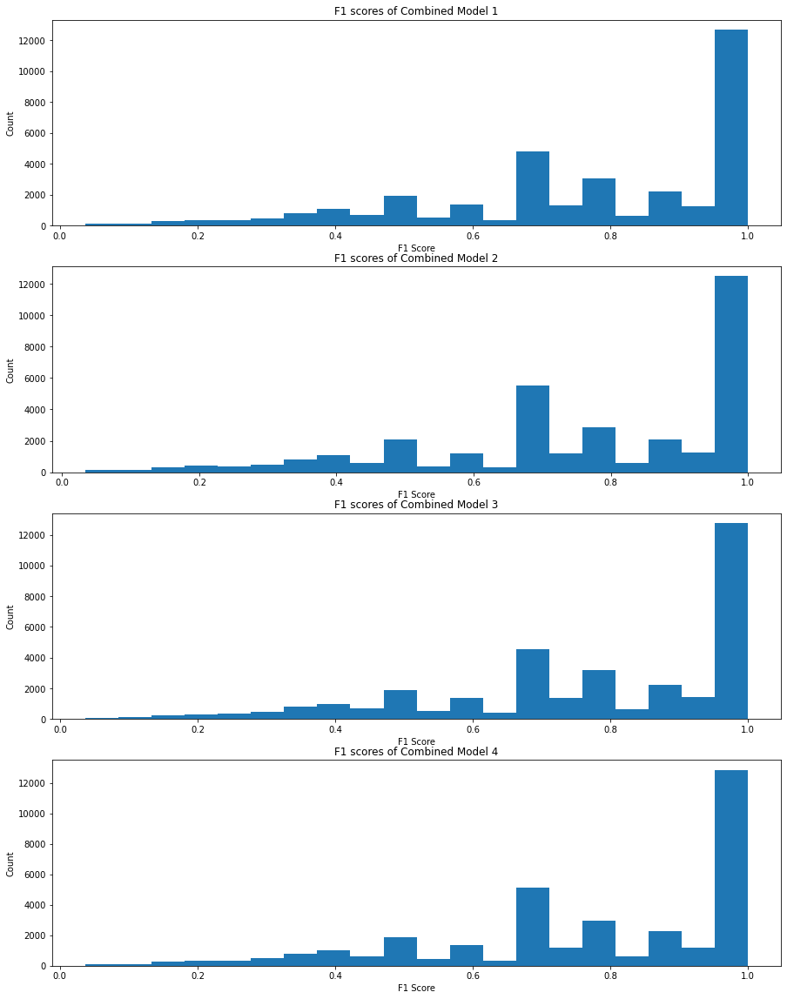

In [95]:
# Check distribution of F1 scores
plt.figure(figsize=(15,5*len(models)))

for i in range(len(models)):
    plt.subplot(len(models), 1, i + 1)
    plt.hist(train[f'combined_scores_{models[i]}'], bins=20)
    plt.ylabel('Count')
    plt.xlabel('F1 Score')
    plt.title(f'F1 scores of Combined Model {models[i]}')

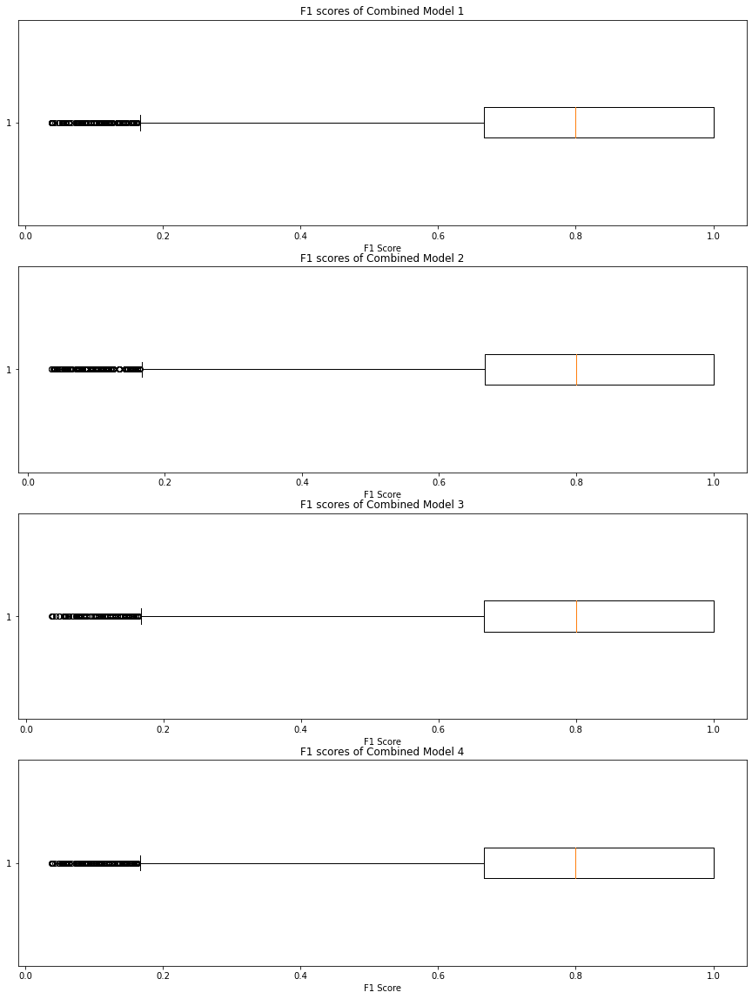

In [96]:
# Check distribution of F1 scores
plt.figure(figsize=(15,5*len(models)))

for i in range(len(models)):
    plt.subplot(len(models), 1, i + 1)
    plt.boxplot(train[f'combined_scores_{models[i]}'], vert=False)
    plt.xlabel('F1 Score')
    plt.title(f'F1 scores of Combined Model {models[i]}');

In [97]:
# Check F1 score value counts
for i in range(len(models)):
    print(f'Most frequent F1 score of combined model {models[i]}')
    print(train[f'combined_scores_{models[i]}'].value_counts().head(10))
    print('')

Most frequent F1 score of combined model 1
1.000000    12405
0.666667     4608
0.800000     2696
0.500000     1759
0.857143     1060
0.571429      898
0.400000      875
0.750000      718
0.888889      690
0.333333      525
Name: combined_scores_1, dtype: int64

Most frequent F1 score of combined model 2
1.000000    12122
0.666667     5322
0.800000     2531
0.500000     1989
0.857143     1056
0.400000      900
0.571429      805
0.750000      673
0.888889      658
0.333333      544
Name: combined_scores_2, dtype: int64

Most frequent F1 score of combined model 3
1.000000    12396
0.666667     4323
0.800000     2757
0.500000     1720
0.857143     1034
0.571429      912
0.400000      840
0.750000      736
0.888889      727
0.333333      473
Name: combined_scores_3, dtype: int64

Most frequent F1 score of combined model 4
1.000000    12536
0.666667     4880
0.800000     2634
0.500000     1745
0.857143     1145
0.571429      876
0.400000      824
0.888889      713
0.750000      643
0.333333 

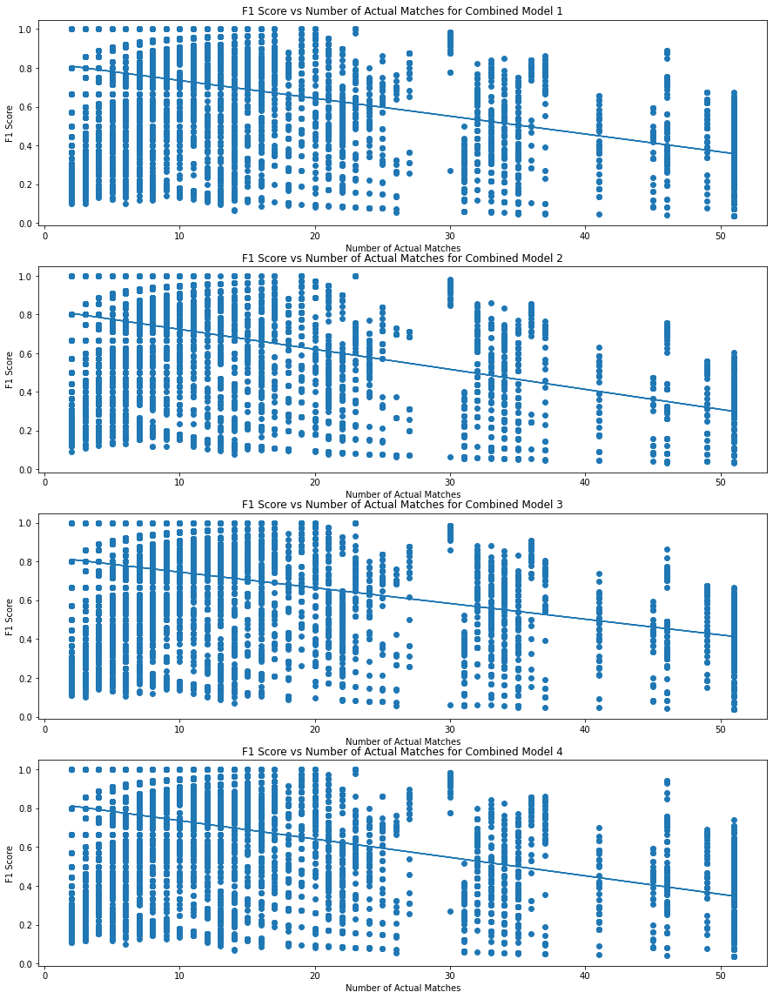

In [98]:
# Check F1 scores by number of matches
plt.figure(figsize = (15,5*len(models)))
x = [(len(match)) for match in train['matches']]

for i in range(len(models)):
    y = train[f'combined_scores_{models[i]}'].astype('float64')
    plt.subplot(len(models), 1, i + 1)
    plt.scatter(x, y)
    m, b = np.polyfit(x, y, 1)
    plt.plot(x, [m*i for i in x] + b)
    plt.xlabel('Number of Actual Matches')
    plt.ylabel('F1 Score')
    plt.title(f'F1 Score vs Number of Actual Matches for Combined Model {models[i]}');

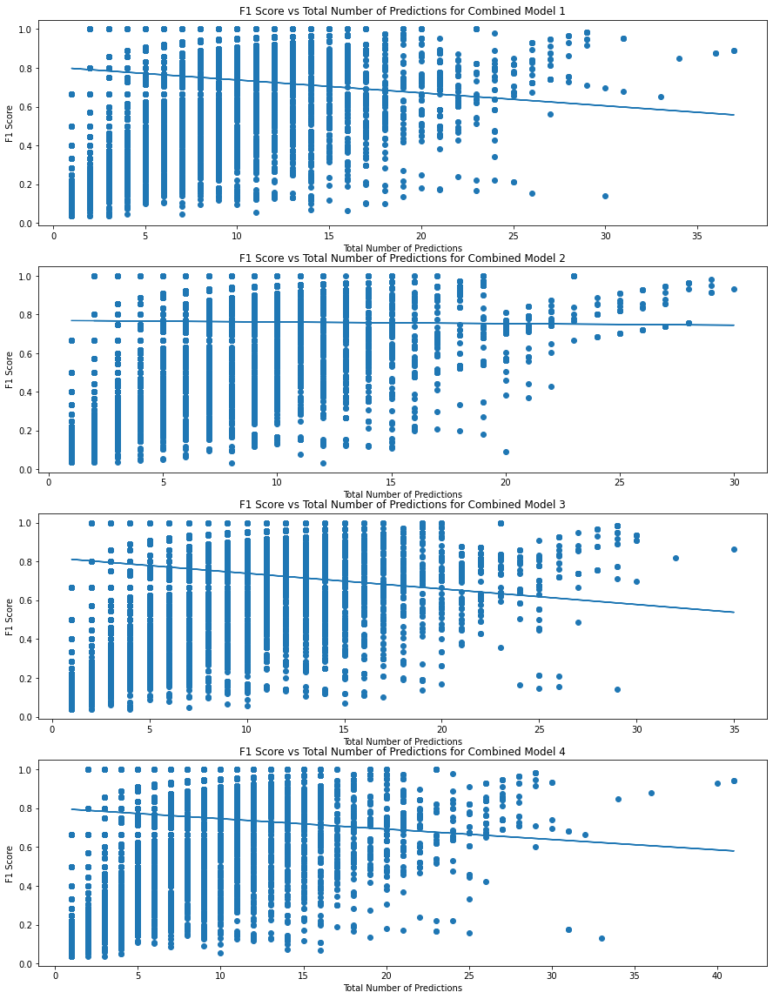

In [99]:
# Check F1 scores by number of predictions
plt.figure(figsize = (15,5*len(models)))

for i in range(len(models)):
    x = [len(pred) for pred in train[f'combined_preds_{models[i]}']]
    y = train[f'combined_scores_{models[i]}'].astype('float64')
    plt.subplot(len(models), 1, i + 1)
    plt.scatter(x, y)
    m, b = np.polyfit(x, y, 1)
    plt.plot(x, [m*i for i in x] + b)
    plt.xlabel('Total Number of Predictions')
    plt.ylabel('F1 Score')
    plt.title(f'F1 Score vs Total Number of Predictions for Combined Model {models[i]}');

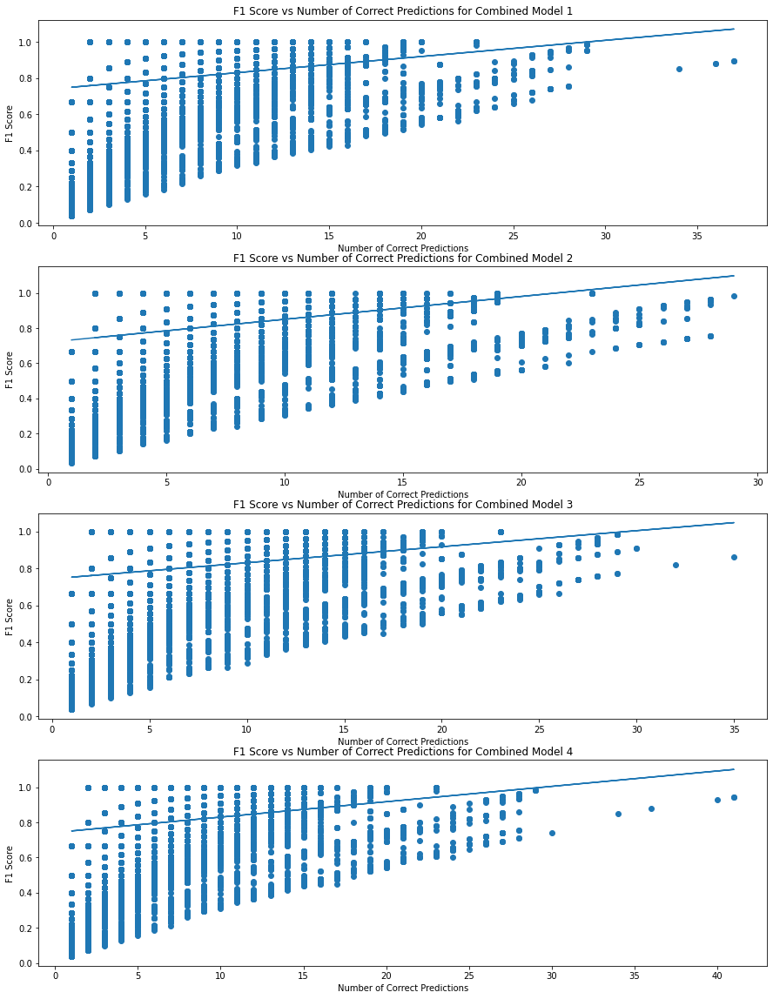

In [100]:
# Check F1 scores by number of correct predictions
plt.figure(figsize = (15,5*len(models)))

for i in range(len(models)):
    x = []
    for j in range(len(train['matches'])):
        x.append(len(np.intersect1d(train['matches'][j], train[f'combined_preds_{models[i]}'][j])))
    y = train[f'combined_scores_{models[i]}'].astype('float64')
    plt.subplot(len(models), 1, i + 1)
    plt.scatter(x, y)
    m, b = np.polyfit(x, y, 1)
    plt.plot(x, [m*i for i in x] + b)
    plt.xlabel('Number of Correct Predictions')
    plt.ylabel('F1 Score')
    plt.title(f'F1 Score vs Number of Correct Predictions for Combined Model {models[i]}');

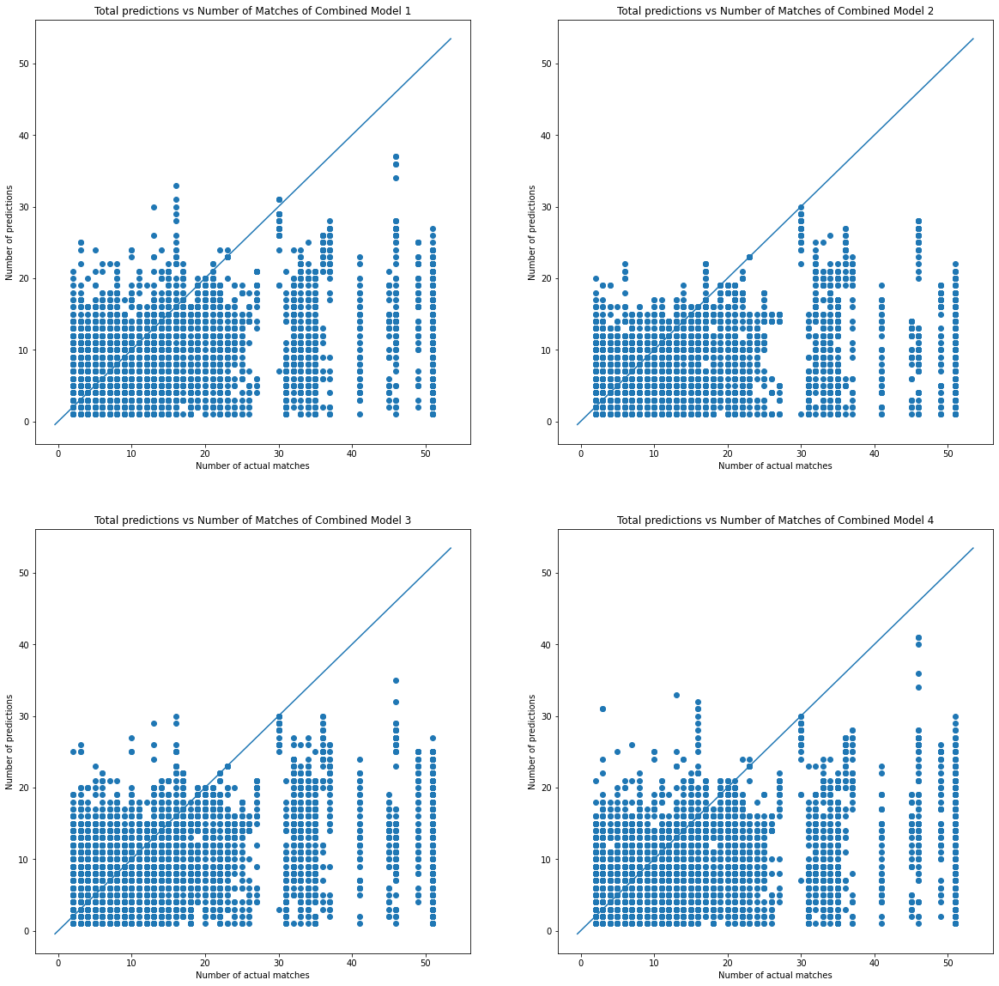

In [101]:
# Check number of predictions vs number of matches
plt.figure(figsize=(20,20))
x = [(len(match)) for match in train['matches']]

for i in range(len(models)):
    y = [len(pred) for pred in train[f'combined_preds_{models[i]}']]
    plt.subplot(2,2,i+1)
    plt.scatter(x, y)
    xpoints = ypoints = plt.xlim()
    plt.plot(xpoints, ypoints)
    plt.xlabel('Number of actual matches')
    plt.ylabel('Number of predictions')
    plt.title(f'Total predictions vs Number of Matches of Combined Model {models[i]}');

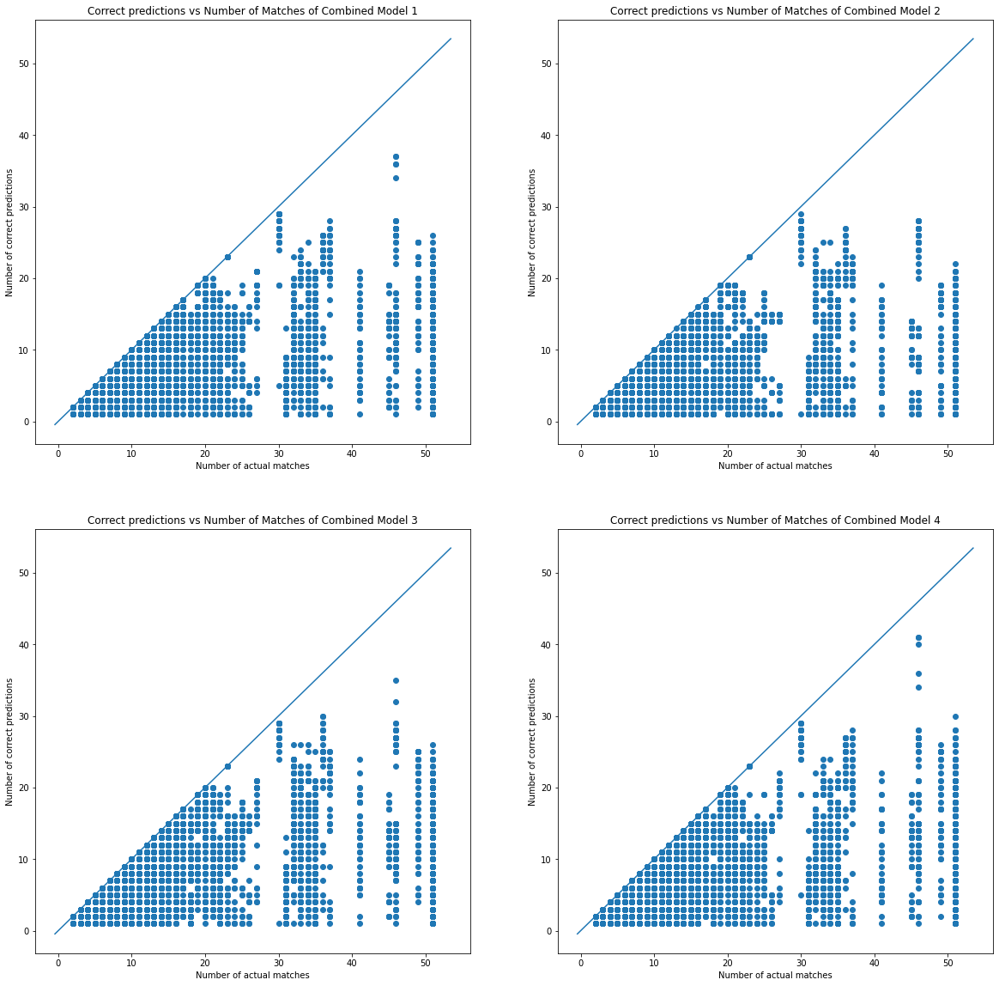

In [102]:
# Check number of correct predictions vs number of matches
plt.figure(figsize=(20,20))
x = [(len(match)) for match in train['matches']]

for i in range(len(models)):
    y = []
    for j in range(len(train['matches'])):
        y.append(len(np.intersect1d(train['matches'][j], train[f'combined_preds_{models[i]}'][j])))
    plt.subplot(2,2,i+1)
    plt.scatter(x, y)
    xpoints = ypoints = plt.xlim()
    plt.plot(xpoints, ypoints)
    plt.xlabel('Number of actual matches')
    plt.ylabel('Number of correct predictions')
    plt.title(f'Correct predictions vs Number of Matches of Combined Model {models[i]}');

### Image and Title Predictions vs Matches

In [5]:
# Create function to plot images of matches or combined predictions
def show_images_combined(df, posting_id, model=0, matches=True, columns=3, width=30, height=10):
    
    # If we are checking for matching images
    if matches:
        group = df.loc[df['posting_id'] == posting_id]['matches'].values[0]

    # If we are checking our combined predictions
    else:
        group = df.loc[df['posting_id'] == posting_id][f'combined_preds_{model}'].values[0]

    height = max(height, int(len(group)/columns) * height)
    plt.figure(figsize=(width, height))

    for i in range(len(group)):
        plt.subplot(len(group) // columns + 1, columns, i + 1)
        im = Image.open(train_dir + df.loc[df['posting_id'] == group[i]]['image'].values[0])
        plt.imshow(im)
        plt.title(df.loc[df['posting_id'] == group[i]]['title'].values[0])

In [6]:
view = ['posting_id', 'title', 'matches',
        'combined_preds_1', 'combined_scores_1',
        'combined_preds_2', 'combined_scores_2',
        'combined_preds_3', 'combined_scores_3',
        'combined_preds_4', 'combined_scores_4',]

#### Predictions with different F1 scores

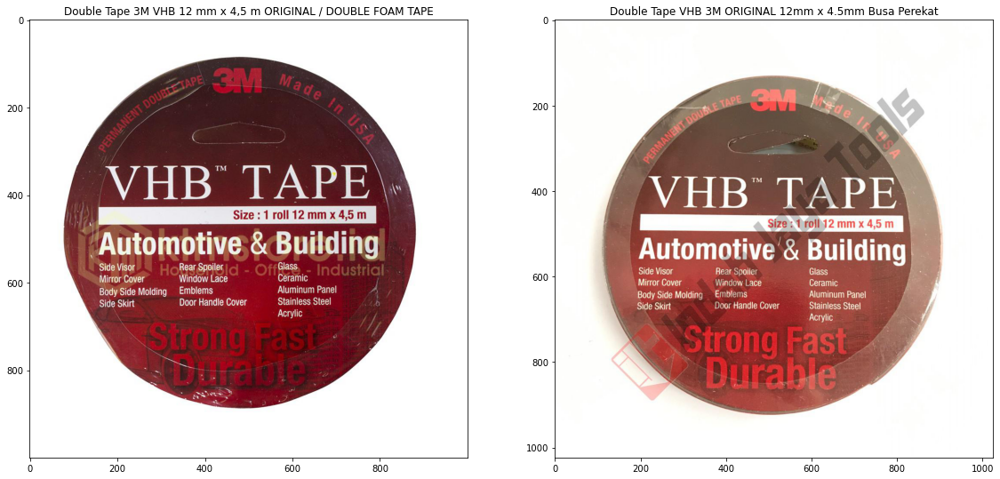

In [7]:
# Show matching images and titles of 'train_4146813717'
show_images_combined(train, 'train_3386243561', matches=True)

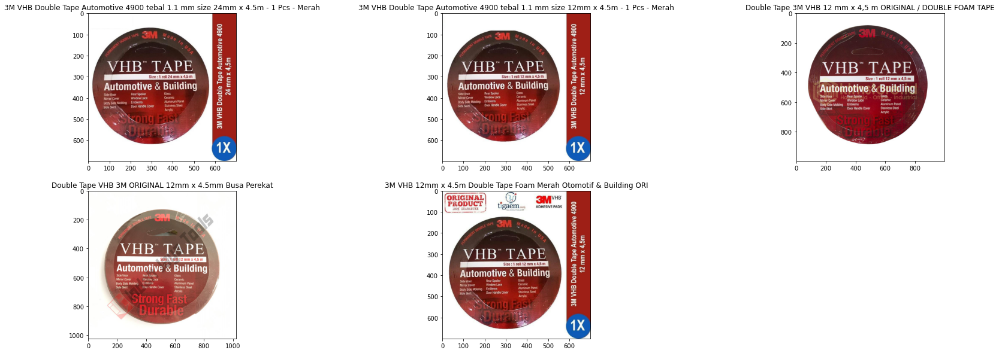

In [8]:
# Show matching images and titles of 'train_4146813717'
show_images_combined(train, 'train_3386243561', model=3, matches=False)

In [105]:
# Check predictions with different F1 scores from each model
train.loc[(train['combined_scores_1'] != train['combined_scores_2']) & (train['combined_scores_2'] != train['combined_scores_3']) &\
          (train['combined_scores_3'] != train['combined_scores_4'])][view].head()

,posting_id,title,matches,combined_preds_1,combined_scores_1,combined_preds_2,combined_scores_2,combined_preds_3,combined_scores_3,combined_preds_4,combined_scores_4
9,train_831680791,BIG SALE SEPATU PANTOFEL KULIT KEREN KERJA KAN...,"[train_831680791, train_3031035861]","[train_3031035861, train_831680791]",1.0,"[train_831680791, train_3031035861, train_1480...",0.8,"[train_148003207, train_2794515317, train_3031...",0.666667,"[train_3031035861, train_831680791]",1.0
16,train_3009013664,MARKS & SPENCER - Rose Hand & Body Lotion 250 ml,"[train_3009013664, train_3448377589]","[train_1248209230, train_236461645, train_3009...",0.571429,"[train_3009013664, train_3448377589, train_124...",0.666667,"[train_1248209230, train_2047191940, train_236...",0.5,"[train_236461645, train_3009013664, train_3448...",0.666667
18,train_2985955659,HnKfashion Sweater Hoodie WHO Printing BabyTer...,"[train_2985955659, train_3916258742, train_415...","[train_2985955659, train_3916258742, train_415...",1.0,"[train_2985955659, train_3916258742, train_415...",0.857143,"[train_1156173438, train_2069761199, train_298...",0.75,"[train_2985955659, train_3916258742, train_415...",1.0
35,train_1640409557,CHIL KID GOLD VANILA 800GR,"[train_1640409557, train_2613418854, train_104...","[train_1047742962, train_1640409557, train_206...",0.6,"[train_1640409557, train_1047742962, train_261...",0.666667,"[train_1047742962, train_1640409557, train_261...",0.5,"[train_1047742962, train_1640409557, train_261...",0.75
38,train_4146813717,Soti Antiseptic Spray 100ml,"[train_4146813717, train_2095066661, train_257...","[train_2095066661, train_2572773207, train_414...",1.0,[train_4146813717],0.5,"[train_2572773207, train_4146813717]",0.8,"[train_2095066661, train_2572773207, train_414...",1.0


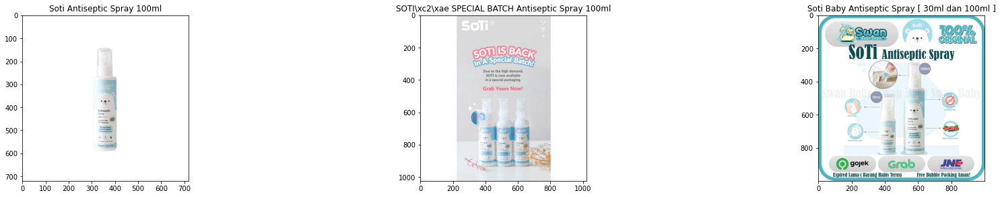

In [111]:
# Show matching images and titles of 'train_4146813717'
show_images_combined(train, 'train_4146813717', matches=True)

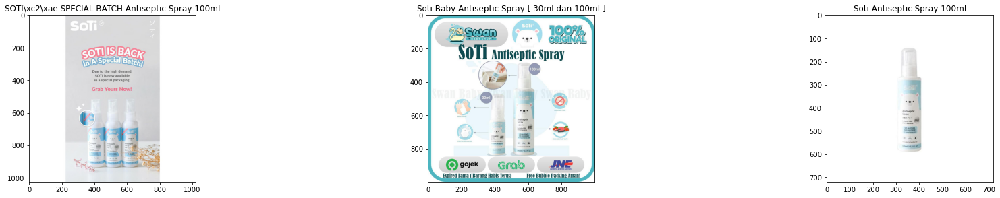

In [112]:
# Show predicted images and titles of 'train_4146813717' from model 1
show_images_combined(train, 'train_4146813717', model=1, matches=False)

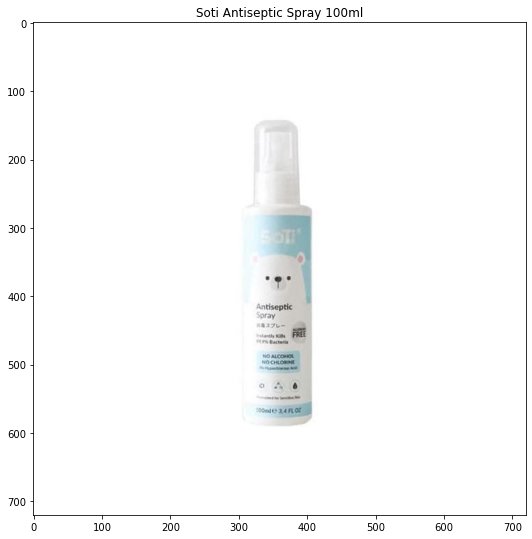

In [113]:
# Show predicted images and titles of 'train_4146813717' from model 2
show_images_combined(train, 'train_4146813717', model=2, matches=False)

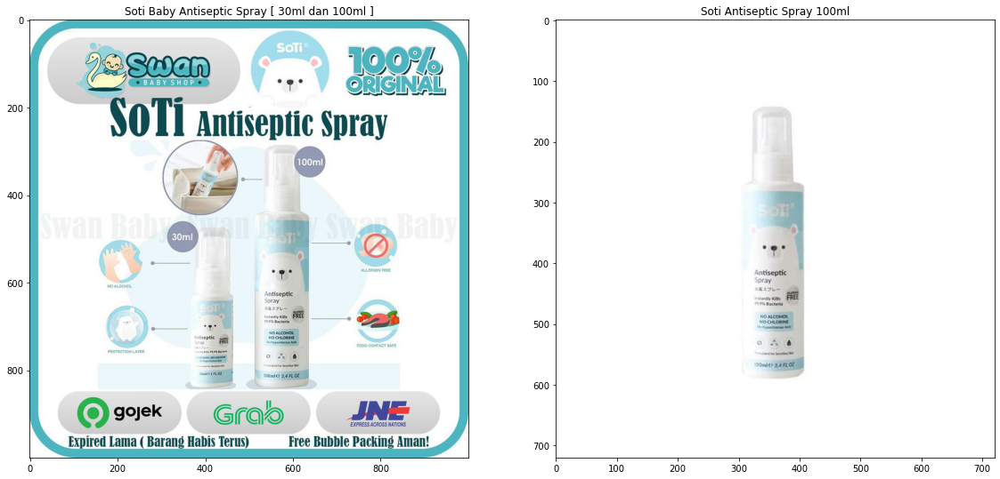

In [114]:
# Show predicted images and titles of 'train_4146813717' from model 3
show_images_combined(train, 'train_4146813717', model=3, matches=False)

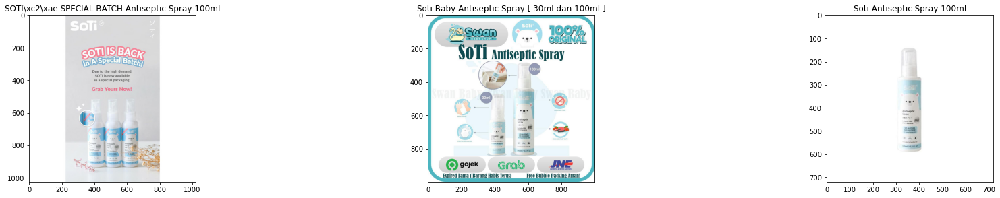

In [115]:
# Show predicted images and titles of 'train_4146813717' from model 4
show_images_combined(train, 'train_4146813717', model=4, matches=False)

#### Predictions with poor F1 scores

In [116]:
# Check predictions with F1 scores < 0.666
train.loc[(train['combined_scores_1'] < 0.666) & (train['combined_scores_2'] < 0.666) &\
          (train['combined_scores_3'] < 0.666) & (train['combined_scores_4'] < 0.666)][view].head()

,posting_id,title,matches,combined_preds_1,combined_scores_1,combined_preds_2,combined_scores_2,combined_preds_3,combined_scores_3,combined_preds_4,combined_scores_4
3,train_2406599165,Daster Batik Lengan pendek - Motif Acak / Camp...,"[train_2406599165, train_3342059966]","[train_1508100548, train_1593362411, train_174...",0.222222,"[train_2406599165, train_3576714541, train_159...",0.4,"[train_1508100548, train_1593362411, train_174...",0.25,"[train_1508100548, train_1593362411, train_174...",0.25
6,train_1802986387,Jubah anak size 1-12 thn,"[train_1802986387, train_1396161074, train_713...","[train_1396161074, train_1802986387]",0.444444,[train_1802986387],0.25,[train_1802986387],0.25,"[train_1396161074, train_1802986387]",0.444444
15,train_4196427721,Korek Kuping LED untuk balita CherryBabyKidsSh...,"[train_4196427721, train_1482447822, train_234...","[train_2221959828, train_3757879175, train_419...",0.5,"[train_4196427721, train_2221959828, train_375...",0.5,"[train_2221959828, train_2590335778, train_375...",0.461538,"[train_2221959828, train_3757879175, train_419...",0.5
22,train_1396146683,CHOCO BALL LAGIE COKLAT Lagie Grosir Cokelat L...,"[train_1396146683, train_2843292969, train_422...","[train_1396146683, train_2382901010, train_252...",0.470588,[train_1396146683],0.166667,"[train_1396146683, train_2527497175, train_284...",0.4,"[train_1396146683, train_2527497175, train_284...",0.4
31,train_2410183091,B33F My Food Shop Shopping Trolley - ST. 003 t...,"[train_2410183091, train_2529718493, train_304...","[train_143394667, train_1504499709, train_2410...",0.571429,"[train_2410183091, train_304181113, train_1433...",0.571429,"[train_143394667, train_1504499709, train_2410...",0.571429,"[train_143394667, train_1504499709, train_2410...",0.571429


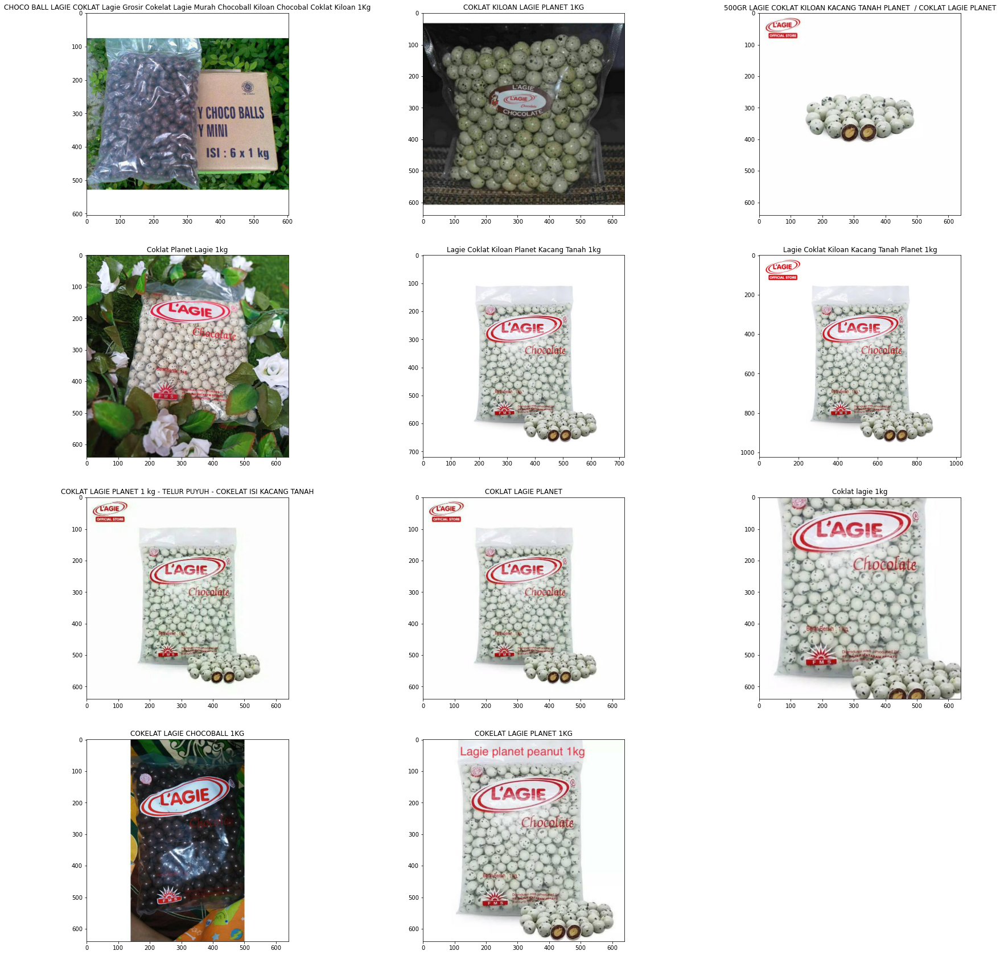

In [117]:
# Show matching images and titles of 'train_1396146683'
show_images_combined(train, 'train_1396146683', matches=True)

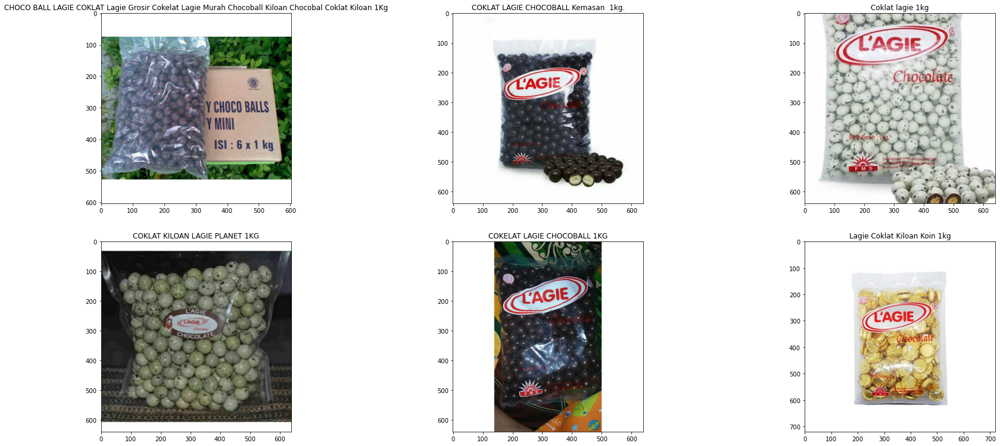

In [118]:
# Show predicted images and titles of 'train_1396146683' from model 1
show_images_combined(train, 'train_1396146683', model=1, matches=False)

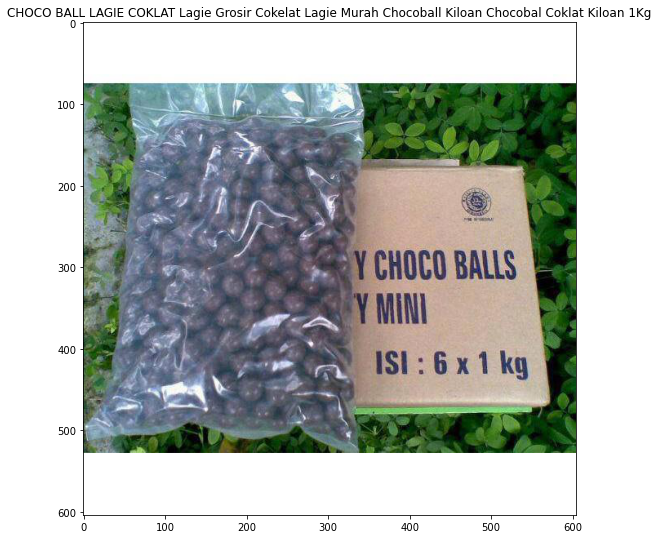

In [119]:
# Show predicted images and titles of 'train_1396146683' from model 2
show_images_combined(train, 'train_1396146683', model=2, matches=False)

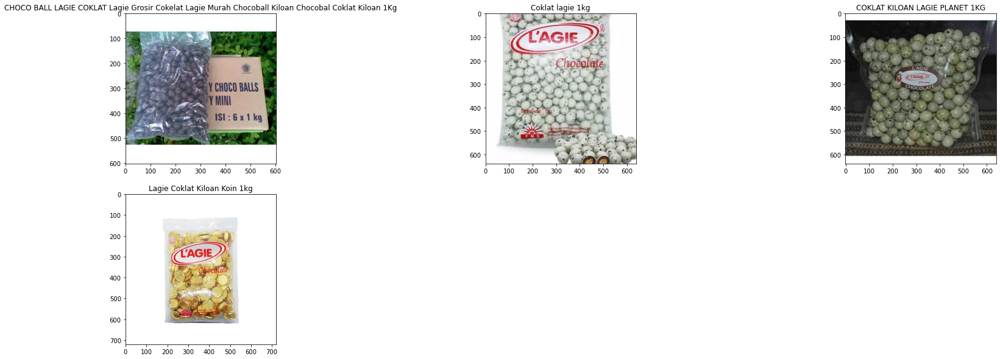

In [120]:
# Show predicted images and titles of 'train_1396146683' from model 3
show_images_combined(train, 'train_1396146683', model=3, matches=False)

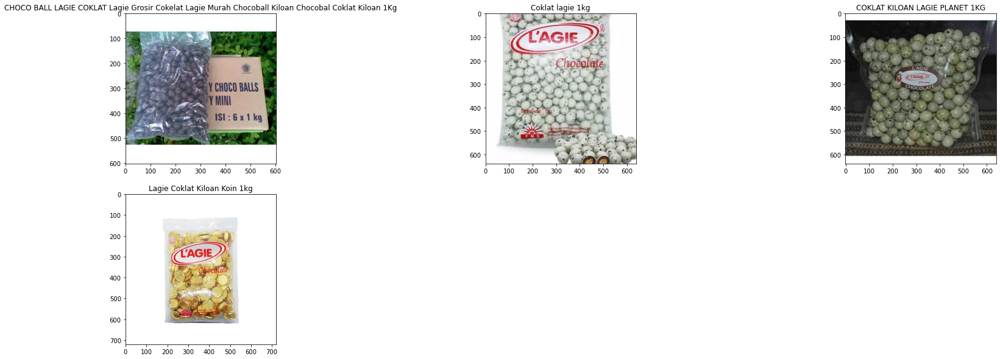

In [121]:
# Show predicted images and titles of 'train_1396146683' from model 4
show_images_combined(train, 'train_1396146683', model=4, matches=False)

#### Predictions for large label groups

In [124]:
# Check label groups larger than 30
train.loc[train['matches'].map(len) > 30].head()

,posting_id,image,image_phash,title,label_group,matches,image_duplicates,combined_preds_1,combined_scores_1,combined_preds_2,combined_scores_2,combined_preds_3,combined_scores_3,combined_preds_4,combined_scores_4
50,train_3497907844,007be583a5a4edc3fc54b0779e141a9f.jpg,9ba6cc31a427a675,ARSHOP MAYCREATE MOISTURIZING UV SPRAY 150ML (...,1141798720,"[train_3497907844, train_4175229751, train_293...",[train_3497907844],"[train_112182868, train_1591104350, train_1913...",0.210526,"[train_3497907844, train_3668806308, train_191...",0.241379,"[train_112182868, train_1591104350, train_1913...",0.271186,"[train_112182868, train_1591104350, train_1913...",0.210526
63,train_1734882388,008a7e4f77c10f36ace0314cff98ba09.jpg,da00a03e871f9f37,TZUKI SOAP 1 PCS,3489985175,"[train_1734882388, train_3043787667, train_285...","[train_1734882388, train_1647008554]","[train_1065224027, train_1420726013, train_164...",0.36,"[train_1734882388, train_1647008554, train_643...",0.255319,"[train_1065224027, train_1085240851, train_142...",0.45283,"[train_1065224027, train_1420726013, train_164...",0.326531
75,train_3043787667,00a798efae9db3d6d5324daebfea2652.jpg,e9949669b54a199d,SABUN TZUKI,3489985175,"[train_1734882388, train_3043787667, train_285...","[train_3043787667, train_2465075561]","[train_1085240851, train_1289188174, train_142...",0.542373,"[train_3043787667, train_2465075561, train_414...",0.561404,"[train_1065224027, train_1085240851, train_128...",0.634921,"[train_1065224027, train_1085240851, train_128...",0.566667
85,train_4175229751,00b9f86046a30f68841671d510077cc6.jpg,a9b6c30b36f03b49,\xe2\x9d\xa4 RATU \xe2\x9d\xa4 MAYCREATE MOIST...,1141798720,"[train_3497907844, train_4175229751, train_293...",[train_4175229751],"[train_2664816648, train_4060693827, train_417...",0.111111,"[train_4175229751, train_2664816648, train_406...",0.111111,"[train_2664816648, train_4060693827, train_417...",0.111111,"[train_2664816648, train_4060693827, train_417...",0.111111
96,train_3879247647,00cefe6ea00dafa4e441757802c72636.jpg,fc8e8e9e87713061,(Bundling 2 Pcs) Acnol Lotion 10Ml Acne Lotion...,1746655739,"[train_3879247647, train_3378866976, train_674...",[train_3879247647],"[train_2954306675, train_3879247647]",0.105263,"[train_3879247647, train_3337799736, train_408...",0.243902,"[train_232453704, train_3337799736, train_3879...",0.243902,"[train_2954306675, train_3337799736, train_387...",0.153846


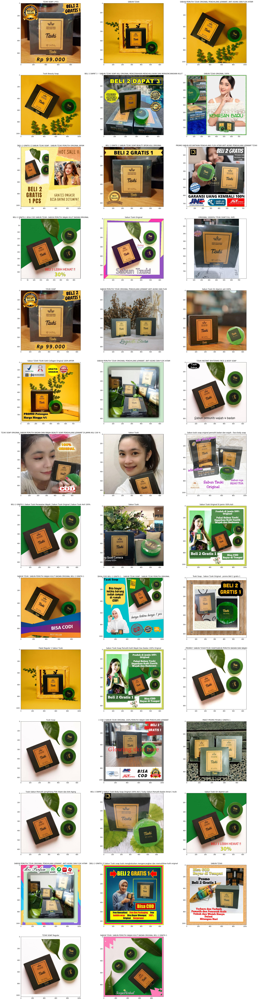

In [125]:
# Show matching images and titles of 'train_1734882388'
show_images_combined(train, 'train_1734882388', matches=True)

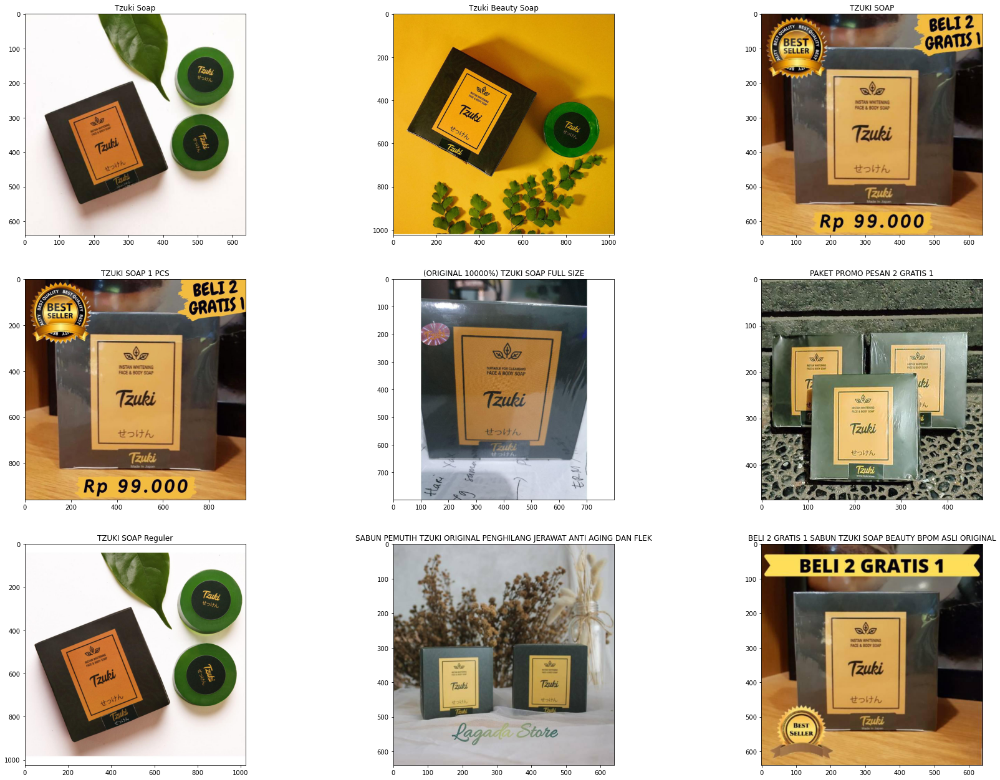

In [126]:
# Show predicted images and titles of 'train_1734882388' from model 1
show_images_combined(train, 'train_1734882388', model=1, matches=False)

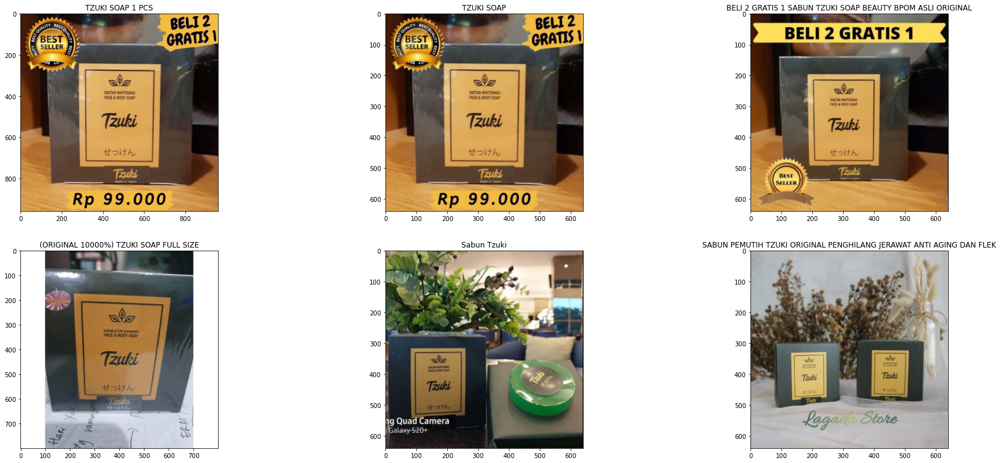

In [127]:
# Show predicted images and titles of 'train_1734882388' from model 2
show_images_combined(train, 'train_1734882388', model=2, matches=False)

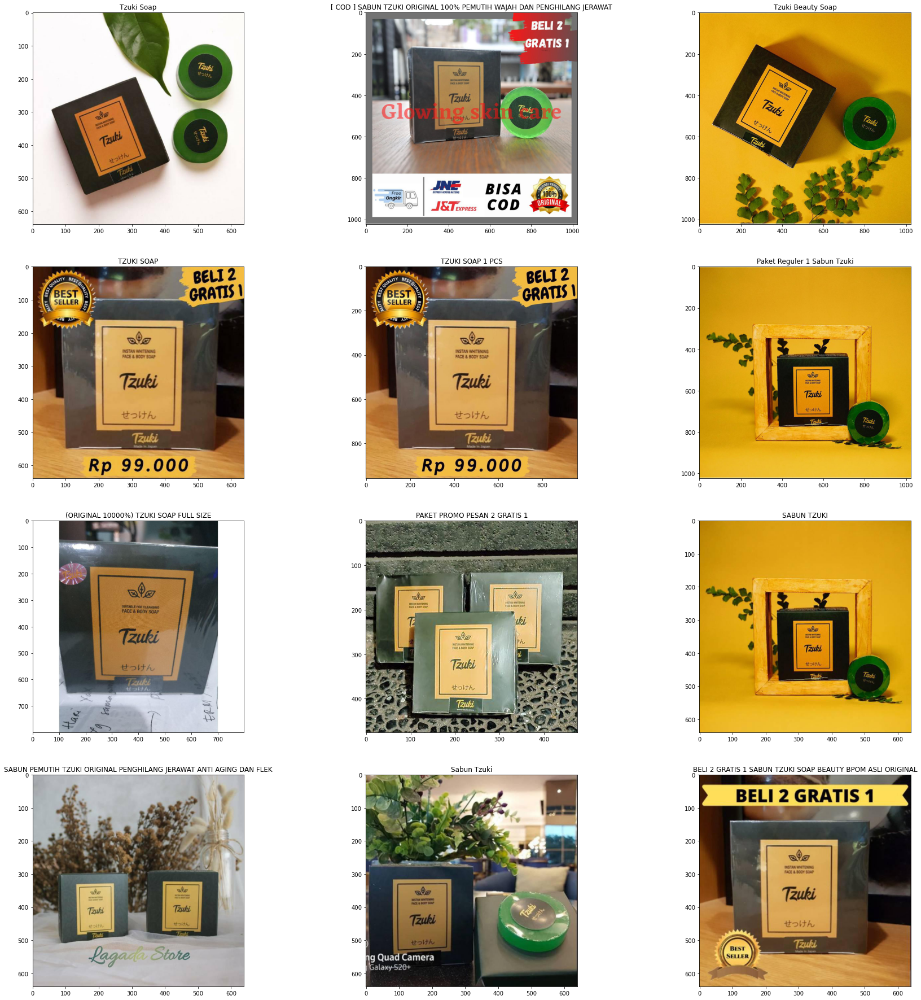

In [128]:
# Show predicted images and titles of 'train_1734882388' from model 3
show_images_combined(train, 'train_1734882388', model=3, matches=False)

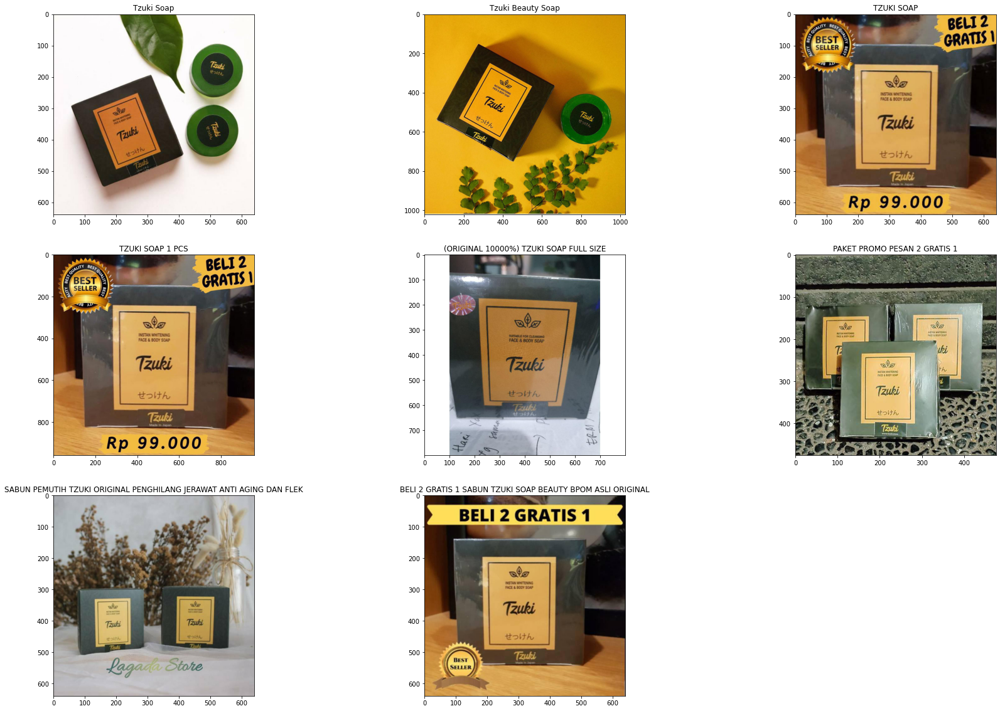

In [129]:
# Show predicted images and titles of 'train_1734882388' from model 4
show_images_combined(train, 'train_1734882388', model=4, matches=False)

## Conclusions and Recommendations

### Model Analysis

As shown in the results and examples above, identical or highly similar images and texts can be easily identified by the models. The image and text embedding process generates similar feature vectors for similar images/texts. The challenge lies in combining image and text predictions, and determining the distance heuristic to predict the right number of neighbours that are actually product matches. Too few or too many predictions will lead to lower scores.

Setting the distance threshold to be a ratio of the average distance of a product's nearest neighbours, rather than a fixed threshold, the number of predictions can be reduced to give a higher score overall. Using an ensemble of different embeddings, the score is also improved as the features generated by different embeddings can be utilised.

Overall, the models perform well except for product matches that are dissimilar in both images and text. In the 'Tzuki Soap' example above, the actual matches comprise varying images and titles that could not be identified by the models.

### Recommendations

More data/metadata on the products may be needed to generate more features that could identify product matches. For example, product matches may originate from the same shop or supplier, have similar prices, are imported from the same location etc. More data that could identify 2 products as being the same, other than image and titles, will be useful.

Product matching could also be achieved using a combination of similarity matching via machine learning plus other heuristics. For example given a list of similar products, if users that view product A always view product B, it could be that products A and B are exactly the same. Such user behavior patterns could be used together with similarity matching to predict product matches.

### Future Improvements

#### Image Embeddings

- Image augmentation when training image embedding models
- Use more powerful EfficientNetB7
- ArcFace separation

#### Text Embeddings

- UTF-8 decoding
- Standardized dimensions
- Refinement of stop words
- Retraining of LaBSE model

#### Prediction Heuristics

- Pair unpaired products. Given that most product matches are pairs, if there are predictions with only size 1, try to find other predictions of size 1 to pair up.
- Flexible use of set union or set intersection. If number of predictions is small, use set union. If number of predictions is large, use intersection.

## References

- Shopee Product Matching Kaggle competition homepage [(link)](https://www.kaggle.com/c/shopee-product-matching/overview)
- Chris Deotte's Kaggle notebook on cuML and EfficientNet APIs, batch embedding generation and Kaggle submission format [(link)](https://www.kaggle.com/cdeotte/part-2-rapids-tfidfvectorizer-cv-0-700)
- Google Language-agnostic BERT Sentence Embedding version 1 [(link)](https://tfhub.dev/google/LaBSE/1)